<a href="https://colab.research.google.com/github/rameshavinash94/CMPE257_MidTerm_Exam/blob/main/Mid_Term_Real_Estate_Exam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**INSTALLING LIBRARIES**

In [ ]:
!pip install autoviz
!pip install sweetviz

In [ ]:
!pip install rfpimp
!pip install boruta
!pip install shap

In [ ]:
exit()

**IMPORTING LIBRARIES**

In [ ]:
import numpy as np
import pandas as pd
import missingno as msno
import seaborn as sns
from matplotlib import pyplot as plt
from collections import Counter
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import sweetviz as sv

# feature selection
from rfpimp import *
from boruta import BorutaPy
import shap

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn import neighbors
from sklearn.model_selection import GridSearchCV
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeRegressor

#Classifiers
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.model_selection import RepeatedKFold

# Model pickling
import pickle

**The Initial dataset provided by professor:**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Inital data
Initial_dataset = pd.read_csv('https://raw.githubusercontent.com/rameshavinash94/CMPE257_MidTerm_Exam/main/Dataset_Realestate.csv')

# Access through GDrive
# Initial_dataset = pd.read_csv('/content/drive/MyDrive/Data Miners/Mid_Term_Exam/Scraped_Dataset/Dataset_Realestate.csv')

In [ ]:
Initial_dataset

,rank,property_id,address,latitude,longitude,price,currency,bathrooms,bedrooms,area,...,rent_zestimate,days_on_zillow,sold_date,is_zillow_owned,image,listing_type,broker_name,input,property_url,listing_url
0,205,70983496,"109 Sunrise Fls, Cibolo, TX 78108",29.599431,-98.254866,296000.0,USD,3.0,3.0,2294.0 sqft,...,2024.0,0.0,NaN,False,https://photos.zillowstatic.com/fp/41ca4905859...,House for sale,Opendoor Brokerage LLC,https://www.zillow.com/homes/TX_rb/,https://www.zillow.com/homedetails/109-Sunrise...,https://www.zillow.com/homes/TX_rb/6_p/
1,711,30429260,"299 Mount Whitney Way, Lake Placid, NY 12946",44.306944,-73.950285,1995000.0,USD,5.0,4.0,3000.0 sqft,...,NaN,0.0,NaN,False,https://photos.zillowstatic.com/fp/3071787e4e5...,House for sale,"Listing by: Merrill L. Thomas, Inc.",https://www.zillow.com/homes/NY_rb/,https://www.zillow.com/homedetails/299-Mount-W...,https://www.zillow.com/homes/NY_rb/18_p/
2,66,97629907,"2910 Persimmon Grv, Richmond, TX 77469",29.557442,-95.751786,425000.0,USD,3.0,2.0,2575.0 sqft,...,2967.0,0.0,NaN,False,https://photos.zillowstatic.com/fp/f4716b346d1...,House for sale,CENTURY 21 Western Realty,https://www.zillow.com/homes/TX_rb/,https://www.zillow.com/homedetails/2910-Persim...,https://www.zillow.com/homes/TX_rb/2_p/
3,222,240296342,"19251 E State Route 106, Belfair, WA 98528",47.427678,-122.855113,895000.0,USD,2.0,2.0,1248.0 sqft,...,1969.0,0.0,NaN,False,https://photos.zillowstatic.com/fp/690e2ee9c08...,Active,NaN,https://www.zillow.com/homes/WA_rb/,https://www.zillow.com/homedetails/19251-E-Sta...,https://www.zillow.com/homes/WA_rb/6_p/
4,444,2076995275,"Clover Plan, The Alpine Collection at Altaira ...",39.813670,-104.765885,391500.0,USD,3.0,4.0,1752.0 sqft,...,1756.0,9.0,NaN,False,https://photos.zillowstatic.com/fp/9b2ae0d3768...,New construction,NaN,"https://www.zillow.com/homes/denver,-co_rb/",https://www.zillow.com/community/alpine-collec...,"https://www.zillow.com/homes/denver,-co_rb/12_p/"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5885,666,48804042,"2218 Bremerton Ave NE, Renton, WA 98059",47.511643,-122.158842,680000.0,USD,3.0,3.0,1770.0 sqft,...,2926.0,0.0,NaN,False,https://photos.zillowstatic.com/fp/6257ffb2491...,Active,NaN,https://www.zillow.com/homes/WA_rb/,https://www.zillow.com/homedetails/2218-Bremer...,https://www.zillow.com/homes/WA_rb/17_p/
5886,594,2068426967,"Taylor Plan, The Hub at Virginia Village",39.680219,-104.922037,644990.0,USD,4.0,4.0,2157.0 sqft,...,NaN,17.0,NaN,False,https://photos.zillowstatic.com/fp/a1758482c49...,New construction,NaN,"https://www.zillow.com/homes/denver,-co_rb/",https://www.zillow.com/community/hub-at-virgin...,"https://www.zillow.com/homes/denver,-co_rb/15_p/"
5887,637,26185150,"126 Kingsman St, Converse, TX 78109",29.503986,-98.305032,210000.0,USD,2.0,4.0,1576.0 sqft,...,1680.0,0.0,NaN,False,https://photos.zillowstatic.com/fp/192eb9595d3...,House for sale,Watters International Realty,https://www.zillow.com/homes/TX_rb/,https://www.zillow.com/homedetails/126-Kingsma...,https://www.zillow.com/homes/TX_rb/16_p/
5888,146,61322711,"2043 Sonador Cmns, San Jose, CA 95128",37.301273,-121.929018,850000.0,USD,3.0,2.0,1860.0 sqft,...,3668.0,3.0,NaN,False,https://photos.zillowstatic.com/fp/9788bda0cd2...,Condo for sale,NaN,"https://www.zillow.com/homes/san-jose,-CA_rb/",https://www.zillow.com/homedetails/2043-Sonado...,"https://www.zillow.com/homes/san-jose,-CA_rb/4_p/"


**Data Properties**

In [ ]:
#dataset shape
Initial_dataset.shape

(5890, 22)

In [ ]:
Initial_dataset.columns

Index(['rank', 'property_id', 'address', 'latitude', 'longitude', 'price',
       'currency', 'bathrooms', 'bedrooms', 'area', 'land_area', 'zestimate',
       'rent_zestimate', 'days_on_zillow', 'sold_date', 'is_zillow_owned',
       'image', 'listing_type', 'broker_name', 'input', 'property_url',
       'listing_url'],
      dtype='object')

<AxesSubplot:>

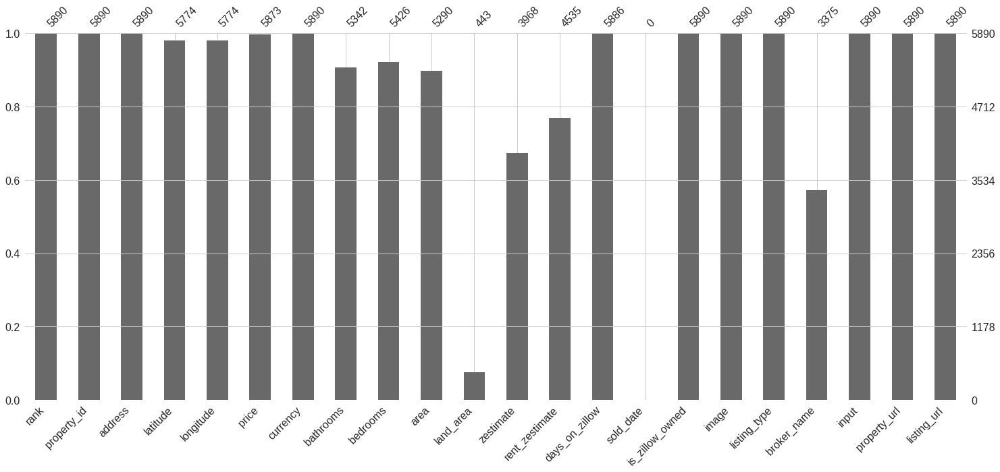

In [ ]:
#checking missing values
msno.bar(Initial_dataset)

**DATA WRANGLING**

**DROP UNNECESSARY FEATURES**

In [ ]:
drop_columns=set()

In [ ]:
#SINCE THE CURRENY IS USD FOR the ENTIRE DATASET LET'S DROP IT
Initial_dataset['currency'].unique()

array(['USD'], dtype=object)

In [ ]:
drop_columns.add('currency')

In [ ]:
# since allmost 90 percent of the dataset is nan for this feature lets drop it
drop_columns.add('land_area')
Initial_dataset['land_area'].isna().sum()

5447

In [ ]:
#sold date is empty for all columns so add it to drop list
drop_columns.add('sold_date')
Initial_dataset['sold_date'].isna().sum()

5890

In [ ]:
#since broker name is categorical and has no impact for our analysis for now let's remove it.
drop_columns.add('broker_name')

#list of unique brokers
len(Initial_dataset['broker_name'].unique())

1528

In [ ]:
#columns to drop
drop_columns

{'broker_name', 'currency', 'land_area', 'sold_date'}

In [ ]:
#final dataframe with dropped features
Dropped_Features = Initial_dataset.drop(columns=drop_columns)

**SIMPLE EDA - TO ANALYSE THE DATA**

In [ ]:
#describe the dataframe
Dropped_Features.describe()

,rank,property_id,latitude,longitude,price,bathrooms,bedrooms,zestimate,rent_zestimate,days_on_zillow
count,5890.000000,5.890000e+03,5774.000000,5774.000000,5.873000e+03,5342.000000,5426.000000,3.968000e+03,4535.000000,5886.000000
mean,363.559253,5.107776e+08,38.377043,-104.911442,8.304924e+05,2.483751,3.137855,8.577364e+05,3322.633738,12.717465
std,234.135877,8.357199e+08,5.381938,15.942067,1.581168e+06,1.172505,1.830358,1.226598e+06,4456.663955,80.691029
min,1.000000,7.644470e+05,25.945941,-124.149685,1.000000e+00,1.000000,0.000000,2.250000e+04,335.000000,-17.000000
25%,152.250000,1.973578e+07,32.992275,-117.296644,2.850000e+05,2.000000,2.000000,3.207305e+05,1892.500000,0.000000
50%,350.000000,6.336051e+07,39.704335,-104.997152,5.199900e+05,2.000000,3.000000,5.719000e+05,2600.000000,1.000000
75%,560.750000,2.953496e+08,41.729149,-94.180766,8.799000e+05,3.000000,4.000000,9.529000e+05,3499.000000,8.000000
max,800.000000,2.146669e+09,48.991824,-71.935199,4.900000e+07,16.000000,99.000000,2.233640e+07,176821.000000,5171.000000


*lets check the type of listing in the dataset*

In [ ]:
#different listing types
Dropped_Features['listing_type'].unique()

array(['House for sale', 'Active', 'New construction', 'Condo for sale',
       'Home for sale', 'Lot / Land for sale',
       'Multi-family home for sale', 'Townhouse for sale', 'Coming soon',
       'Auction', 'Foreclosure', 'Apartment for sale', 'New'],
      dtype=object)

In [ ]:
listing_type_count = Dropped_Features.groupby('listing_type')['rank'].count().to_frame()

In [ ]:
listing_type_count.rename(columns={'rank':'Count'},inplace=True)

**Plot Pie Chart**

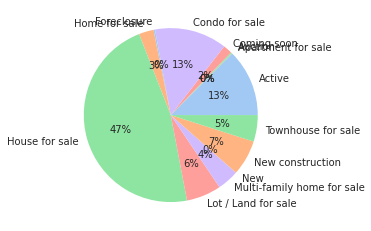

In [ ]:
#define Seaborn color palette to use

colors = sns.color_palette('pastel')[0:5]

#create pie chart
plt.pie(listing_type_count['Count'], labels = listing_type_count.index, colors = colors, autopct='%.0f%%')
sns.set(rc = {'figure.figsize':(20,10)})
plt.show()

*Properties based on State*

In [ ]:
state_codes=Dropped_Features['address'].str.split(' ').str[-2]

In [ ]:
correct_codes=[]
needed_fix=[]
for x,y in enumerate(state_codes):
    if len(y) > 2 or y=='3' or y =='St' or y =='at':
        needed_fix.append(x)
    else:
        correct_codes.append(y)

In [ ]:
#193 addess without state and zip codes.
Dropped_Features.loc[needed_fix,['address']]

,address
4,"Clover Plan, The Alpine Collection at Altaira ..."
22,"Bellhaven Plan, Southbridge Farms"
151,"Edmon Plan, Southbridge Farms"
206,"Vail Plan, Kipling Park West: Paired Homes"
211,"Ruby Plan, Heritage at Grimes"
...,...
5724,"Aster Plan, The Horizon Collection at Altaira ..."
5736,"Residence 1 Plan, Canopy Grove Reflection"
5770,"Hamilton Plan, Trestle Ridge Villas"
5815,"Plan Wales Plan, Creekside"


In [ ]:
#correct codes
len(correct_codes)

5674

In [ ]:
#counter for Codes by State
correct_codes_counter = Counter(correct_codes)

In [ ]:
#State wise property count
correct_codes_counter

Counter({'CA': 1824,
         'CO': 725,
         'IA': 757,
         'ME': 1,
         'NY': 800,
         'TX': 771,
         'WA': 796})

Text(0.5, 1.0, 'Statewise Property Count')

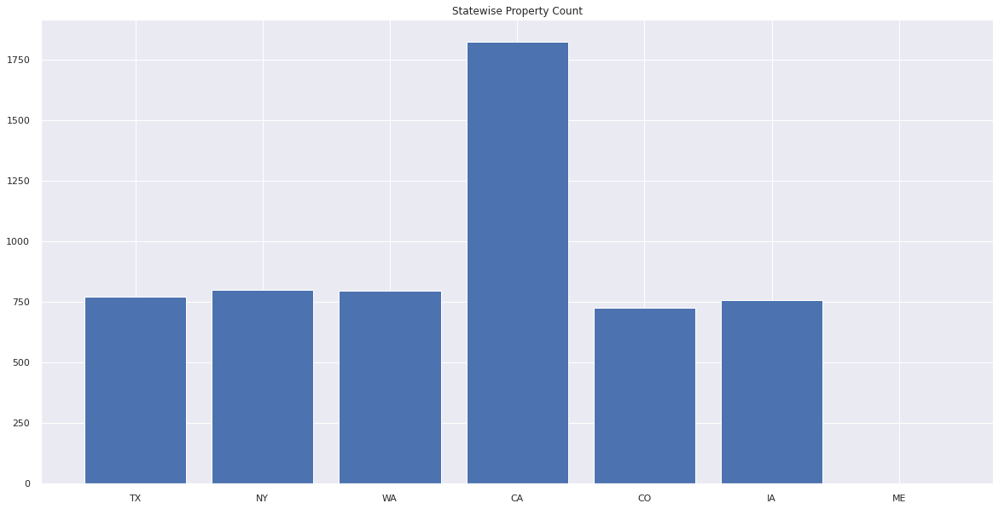

In [ ]:
plt.bar(range(len(correct_codes_counter)), correct_codes_counter.values(), tick_label=list(correct_codes_counter.keys()))
plt.title('Statewise Property Count')

*From the above chart, we can say most of the property lisitngs are from CA*

*merge state info with dataset to perform further analysis*

In [ ]:
state_info = state_codes[state_codes.isin(set(correct_codes))]

**Avg Price by states and by listing**

In [ ]:
#merge state_info and df to perform analysis
state_listing_price = pd.merge(Dropped_Features.loc[:,['price','listing_type']],state_info,left_index=True,right_index=True)

In [ ]:
#view df
state_listing_price.head()

,price,listing_type,address
0,296000.0,House for sale,TX
1,1995000.0,House for sale,NY
2,425000.0,House for sale,TX
3,895000.0,Active,WA
5,225000.0,Active,WA


In [ ]:
np.unique(correct_codes)

array(['CA', 'CO', 'IA', 'ME', 'NY', 'TX', 'WA'], dtype='<U2')

<AxesSubplot:xlabel='address,listing_type'>

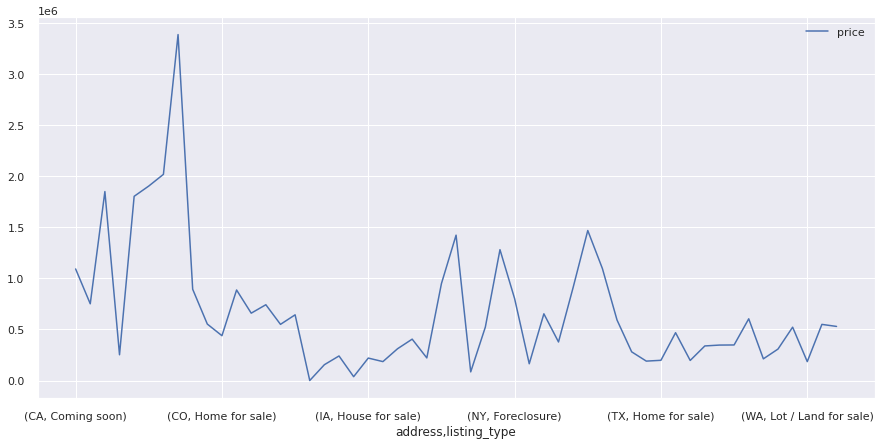

In [ ]:
#group state,listing type and compute average price

fig, ax = plt.subplots(figsize=(15,7))

state_listing_price.groupby(['address','listing_type']).mean().plot(ax=ax)

<AxesSubplot:xlabel='address'>

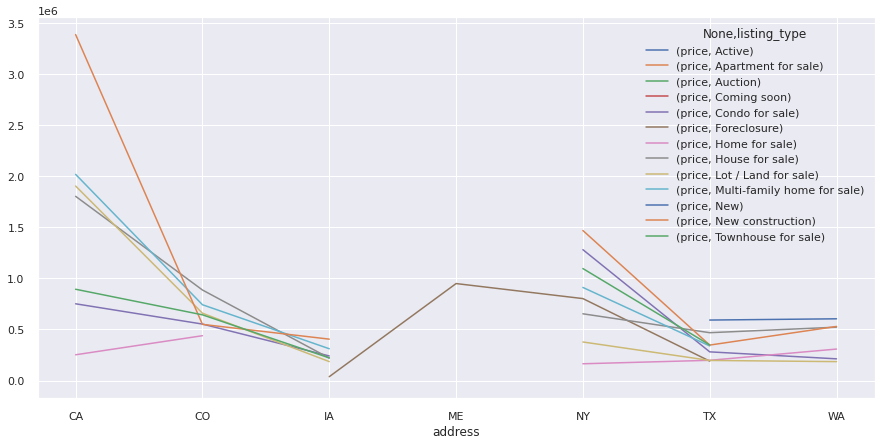

In [ ]:
#group state,listing type and compute average price

fig, ax = plt.subplots(figsize=(15,7))

state_listing_price.groupby(['address','listing_type']).mean().unstack().plot(ax=ax)

From the above 2 charts, we can say that prices of Apartments seem to be higher...

prices of properties in CA,NY are pretty higher compared to other states.

**Adding Scapped dataset with our dataset for analysis**

Scrapping is Done in a seperate colab.
Final Scrapped Dataset is stored in drive.

**File Info**:

_Crime_scrape : Contains Info about the crime rate with respect to zipcode_

_walk_score : Contains Info about the Walk Score, Bike Score, Transit Score with respect to zipcode_

_zipcode_rankings : Contains Info about the School rank,Diversity Rank, Family preference,Liveablilty Score with respect to zipcode_

https://www.walkscore.com/

https://www.bestplaces.net/crime/

https://www.niche.com/places-to-live/

In [ ]:
#read the scraped data in the dataframe
crime_rate = pd.read_csv('https://raw.githubusercontent.com/rameshavinash94/CMPE257_MidTerm_Exam/main/Crime_scrape.csv')
walk_score = pd.read_csv('https://raw.githubusercontent.com/rameshavinash94/CMPE257_MidTerm_Exam/main/walk_score.csv')
main_csv = pd.read_csv('https://raw.githubusercontent.com/rameshavinash94/CMPE257_MidTerm_Exam/main/Dataset_Realestate.csv')
school_csv = pd.read_csv('https://raw.githubusercontent.com/rameshavinash94/CMPE257_MidTerm_Exam/main/zipcode_rankings.csv')

# Access through GDrive
# crime_rate = pd.read_csv('/content/drive/MyDrive/Data Miners/Mid_Term_Exam/Scraped_Dataset/Crime_scrape.csv')
# walk_score = pd.read_csv('/content/drive/MyDrive/Data Miners/Mid_Term_Exam/Scraped_Dataset/walk_score.csv')
# main_csv = pd.read_csv('/content/drive/MyDrive/Data Miners/Mid_Term_Exam/Scraped_Dataset/Dataset_Realestate.csv')
# school_csv = pd.read_csv('/content/drive/MyDrive/Data Miners/Mid_Term_Exam/Scraped_Dataset/zipcode_rankings.csv')

In [ ]:
# crime rate dataset info
crime_rate.head()

,Zipcode,Violent Crime,Property Crime
0,98327,17.6,23.6
1,77079,42.4,54.0
2,15921,21.2,25.5
3,77573,14.2,21.2
4,10030,64.3,67.2


In [ ]:
# walk score dataset info
walk_score.head()

,Unnamed: 0,Address,Walk_Score,Transit_Score,Bike_Score
0,0,"109 Sunrise Fls, Cibolo, TX 78108",34,0,32
1,1,"299 Mount Whitney Way, Lake Placid, NY 12946",0,0,0
2,2,"2910 Persimmon Grv, Richmond, TX 77469",13,0,29
3,3,"19251 E State Route 106, Belfair, WA 98528",7,0,0
4,4,"Clover Plan, The Alpine Collection at Altaira ...",14,18,37


In [ ]:
# zipcode score dataset info
school_csv.head()

,Zipcode,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse
0,98304,0,0,0,0
1,98310,"3,574","10,021",70,174
2,98312,"5,998","7,684","9,552","9,741"
3,98321,"5,610","8,619",109,157
4,98327,"2,363","2,822","4,336","5,659"


In [ ]:
#loop thorugh the School Csv and replace 0 with Nan for our understanding since while scraping we mentioned zip codes with no rankings as 0
for col in school_csv.columns[1:]:
  school_csv[col] = school_csv[col].replace(to_replace='0', value=np.nan)

In [ ]:
#merge crime rate and zipcode ranking datasets
tmp_crime_school = pd.merge(crime_rate, school_csv)

In [ ]:
tmp_crime_school.head()

,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse
0,98327,17.6,23.6,"2,363","2,822","4,336","5,659"
1,77079,42.4,54.0,727,823,"1,378","1,736"
2,77573,14.2,21.2,425,600,"1,027","1,126"
3,10030,64.3,67.2,"2,125","7,763","8,843",158
4,98366,33.1,47.3,"6,210",140,90,7


In [ ]:
#check nan
tmp_crime_school.isna().sum()

Zipcode                     0
Violent Crime               0
Property Crime              0
Zip_code_Rank_to_live     319
Zip_code_Rank_Families    319
Zip_code_Rank_schools     331
Zip_code_Rank_Diverse     370
dtype: int64

In [ ]:
#modify datatype to str
tmp_crime_school['Zipcode'] = tmp_crime_school['Zipcode'].astype(str)

In [ ]:
for col in school_csv.columns:
  tmp_crime_school[col] = tmp_crime_school[col].replace(to_replace=',', value='', regex = True)
  # tmp_crime_school[col] = tmp_crime_school[col].astype(int)

In [ ]:
#rename column to perform join
walk_score.rename(columns = {'Address':'address'}, inplace = True)

#join with main dataset
tmp_main_walk = pd.merge(main_csv, walk_score).drop(columns = ['Unnamed: 0'])

In [ ]:
#extract the zipcode
tmp_main_walk['Zipcode'] = tmp_main_walk['address'].str.extract(r'(\d{5}$)')

In [ ]:
#check shape
tmp_main_walk.shape

(5988, 26)

In [ ]:
# tmp_main_crime is by combining all dataframe together for final df
tmp_main_crime = pd.merge(tmp_main_walk, tmp_crime_school, how = "left")

In [ ]:
tmp_main_crime.isna().sum()

rank                         0
property_id                  0
address                      0
latitude                   116
longitude                  116
price                       17
currency                     0
bathrooms                  550
bedrooms                   466
area                       610
land_area                 5543
zestimate                 1957
rent_zestimate            1380
days_on_zillow               4
sold_date                 5988
is_zillow_owned              0
image                        0
listing_type                 0
broker_name               2551
input                        0
property_url                 0
listing_url                  0
Walk_Score                   0
Transit_Score                0
Bike_Score                   0
Zipcode                    224
Violent Crime              440
Property Crime             440
Zip_code_Rank_to_live      860
Zip_code_Rank_Families     860
Zip_code_Rank_schools      893
Zip_code_Rank_Diverse      977
dtype: i

In [ ]:
#perfrom data cleaning.
tmp_main_crime['area'] = tmp_main_crime['area'].str.split('sqft').str[0]
tmp_main_crime['area'] = tmp_main_crime['area'].astype(float)
tmp_main_crime['Zip_code_Rank_to_live'] = tmp_main_crime['Zip_code_Rank_to_live'].astype(float)
tmp_main_crime['Zip_code_Rank_Families'] = tmp_main_crime['Zip_code_Rank_Families'].astype(float)
tmp_main_crime['Zip_code_Rank_schools'] = tmp_main_crime['Zip_code_Rank_schools'].astype(float)
tmp_main_crime['Zip_code_Rank_Diverse'] = tmp_main_crime['Zip_code_Rank_Diverse'].astype(float)
tmp_main_crime.dropna(subset = ['Zipcode'], inplace = True)
tmp_main_crime['Zipcode'] = tmp_main_crime['Zipcode'].astype(int)

In [ ]:
tmp_main_crime.head()

,rank,property_id,address,latitude,longitude,price,currency,bathrooms,bedrooms,area,...,Walk_Score,Transit_Score,Bike_Score,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse
0,205,70983496,"109 Sunrise Fls, Cibolo, TX 78108",29.599431,-98.254866,296000.0,USD,3.0,3.0,2294.0,...,34,0,32,78108,12.9,18.3,1772.0,1905.0,2182.0,2659.0
1,711,30429260,"299 Mount Whitney Way, Lake Placid, NY 12946",44.306944,-73.950285,1995000.0,USD,5.0,4.0,3000.0,...,0,0,0,12946,29.0,36.4,6586.0,8171.0,442.0,471.0
2,66,97629907,"2910 Persimmon Grv, Richmond, TX 77469",29.557442,-95.751786,425000.0,USD,3.0,2.0,2575.0,...,13,0,29,77469,26.8,30.9,70.0,1481.0,2230.0,2362.0
3,222,240296342,"19251 E State Route 106, Belfair, WA 98528",47.427678,-122.855113,895000.0,USD,2.0,2.0,1248.0,...,7,0,0,98528,30.1,39.9,6644.0,158.0,2.0,NaN
5,209,61946745,"332 C St SW, Ephrata, WA 98823",47.317560,-119.555181,225000.0,USD,1.0,3.0,2053.0,...,67,0,53,98823,26.5,40.8,4352.0,5179.0,5641.0,6357.0


In [ ]:
#getting the categorical features from the dataset
categorical = tmp_main_crime.dtypes[tmp_main_crime.dtypes=='object']

In [ ]:
categorical

address         object
currency        object
land_area       object
image           object
listing_type    object
broker_name     object
input           object
property_url    object
listing_url     object
dtype: object

In [ ]:
#drop these features as they are not needed for analysis
tmp_reg = tmp_main_crime.drop(columns=categorical.index)

In [ ]:
#we also do'nt need these features as there are pretty much null and some are out of scope for our analysis
tmp_reg = tmp_reg.drop(columns=['sold_date', 'property_id', 'is_zillow_owned'])

**DATA IMPUTATION USING IMPUTERS**

In [ ]:
#lets use imputer to fill the miising values
#KNN imputer
from sklearn.impute import KNNImputer
nan = np.nan
imputer = KNNImputer(n_neighbors=3, weights="uniform")
main_crime_imp_knn = pd.DataFrame(imputer.fit_transform(tmp_reg), columns = tmp_reg.columns)

In [ ]:
#lets use imputer to fill the miising values
#Iterative Imputer
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
imp = IterativeImputer(max_iter=10, random_state=0)
main_crime_imp_itr = pd.DataFrame(imp.fit_transform(tmp_reg), columns = tmp_reg.columns)

In [ ]:
#view imputations of KNN
main_crime_imp_knn.head()

,rank,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,Walk_Score,Transit_Score,Bike_Score,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse
0,205.0,29.599431,-98.254866,296000.0,3.0,3.0,2294.0,2.701000e+05,2024.000000,0.0,34.0,0.0,32.0,78108.0,12.9,18.3,1772.0,1905.0,2182.0,2659.0
1,711.0,44.306944,-73.950285,1995000.0,5.0,4.0,3000.0,1.641767e+06,6914.333333,0.0,0.0,0.0,0.0,12946.0,29.0,36.4,6586.0,8171.0,442.0,471.0
2,66.0,29.557442,-95.751786,425000.0,3.0,2.0,2575.0,4.360000e+05,2967.000000,0.0,13.0,0.0,29.0,77469.0,26.8,30.9,70.0,1481.0,2230.0,2362.0
3,222.0,47.427678,-122.855113,895000.0,2.0,2.0,1248.0,9.078493e+05,1969.000000,0.0,7.0,0.0,0.0,98528.0,30.1,39.9,6644.0,158.0,2.0,4291.0
4,209.0,47.317560,-119.555181,225000.0,1.0,3.0,2053.0,2.314000e+05,1497.000000,0.0,67.0,0.0,53.0,98823.0,26.5,40.8,4352.0,5179.0,5641.0,6357.0


In [ ]:
#view imputations of Iterative Imputer
main_crime_imp_itr.head()

,rank,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,Walk_Score,Transit_Score,Bike_Score,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse
0,205.0,29.599431,-98.254866,296000.0,3.0,3.0,2294.0,2.701000e+05,2024.000000,0.0,34.0,0.0,32.0,78108.0,12.9,18.3,1772.0,1905.0,2182.0,2659.000000
1,711.0,44.306944,-73.950285,1995000.0,5.0,4.0,3000.0,1.477398e+06,5259.971354,0.0,0.0,0.0,0.0,12946.0,29.0,36.4,6586.0,8171.0,442.0,471.000000
2,66.0,29.557442,-95.751786,425000.0,3.0,2.0,2575.0,4.360000e+05,2967.000000,0.0,13.0,0.0,29.0,77469.0,26.8,30.9,70.0,1481.0,2230.0,2362.000000
3,222.0,47.427678,-122.855113,895000.0,2.0,2.0,1248.0,8.213284e+05,1969.000000,0.0,7.0,0.0,0.0,98528.0,30.1,39.9,6644.0,158.0,2.0,3414.299421
4,209.0,47.317560,-119.555181,225000.0,1.0,3.0,2053.0,2.314000e+05,1497.000000,0.0,67.0,0.0,53.0,98823.0,26.5,40.8,4352.0,5179.0,5641.0,6357.000000


Choosing one of the  above imputed dataset as final datase from above for Analysis

**VISUALIZE USING PAIRPLOT**

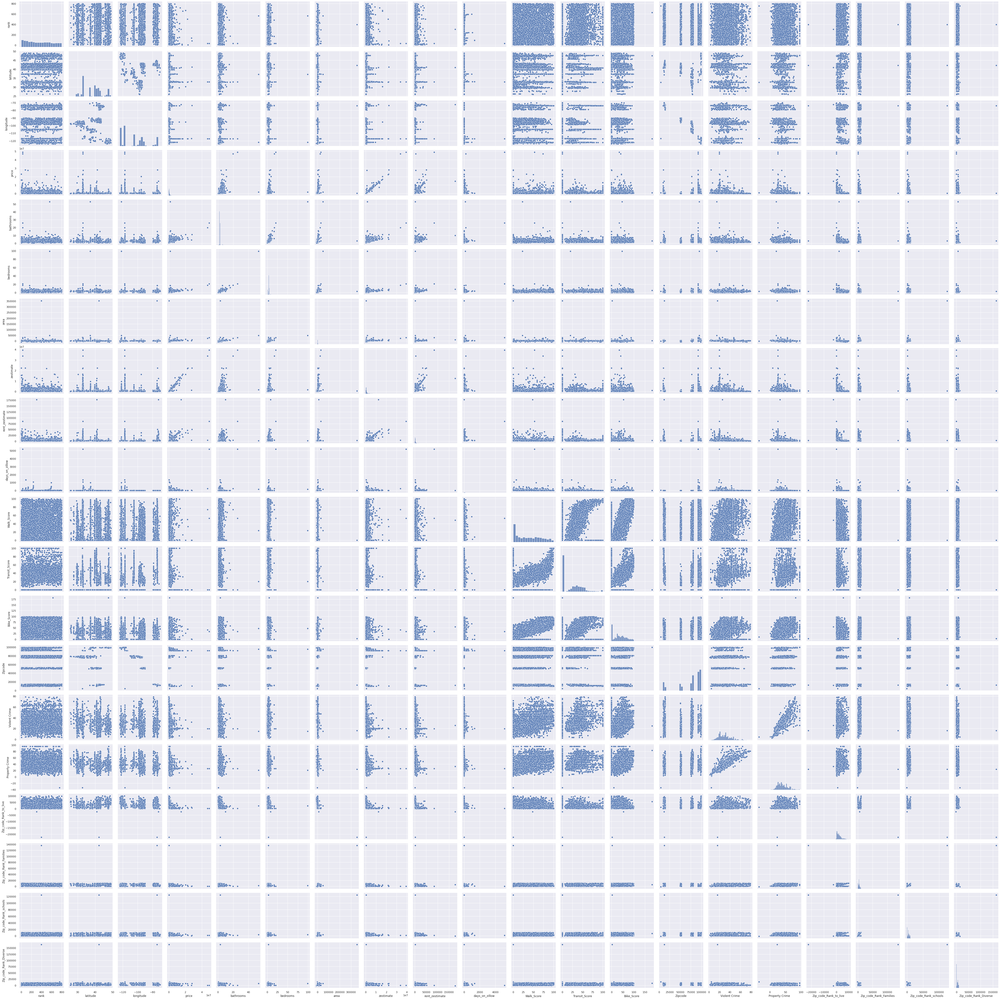

In [ ]:
sns.pairplot(main_crime_imp_itr, height = 3)

**REDUCE DIMENSION AND PLOT DATA FOR VISUALIZATION**

In [ ]:
PCA_df = main_crime_imp_itr
pca = PCA(n_components=2)
values = pca.fit_transform(PCA_df)

In [ ]:
print(pca.explained_variance_)
print(pca.explained_variance_ratio_)
print(pca.explained_variance_ratio_.cumsum())

[4.29473565e+12 9.43887140e+10]
[0.97830249 0.02150091]
[0.97830249 0.9998034 ]


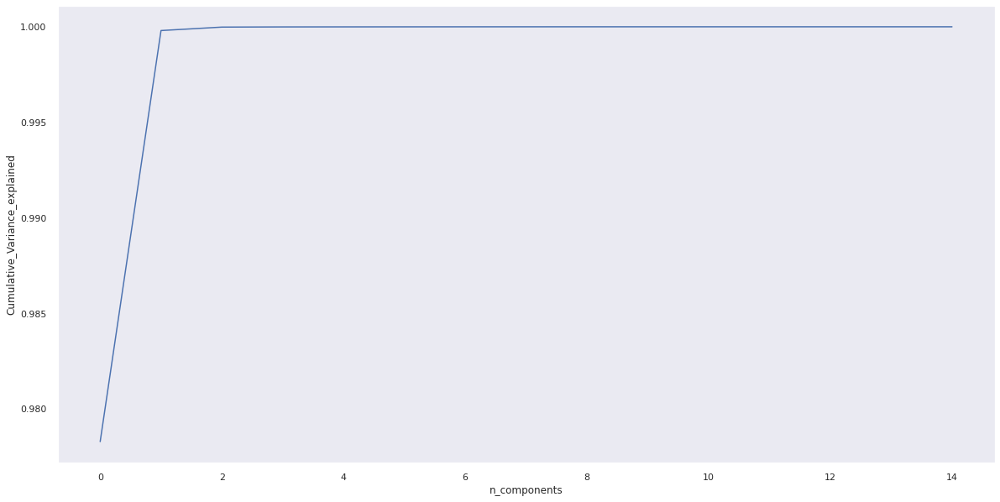

In [ ]:
#plotting pca with variance of different components
pca=PCA()  
pca.n_components=15  
pca_data=pca.fit_transform(PCA_df)
percentage_var_explained = pca.explained_variance_ratio_ 
cum_var_explained=np.cumsum(percentage_var_explained)

fig, ax = plt.subplots()

ax.plot(cum_var_explained)
ax.axis('tight')
ax.set_xlabel('n_components') 
ax.set_ylabel('Cumulative_Variance_explained')   
ax.grid()
plt.show()

<AxesSubplot:>

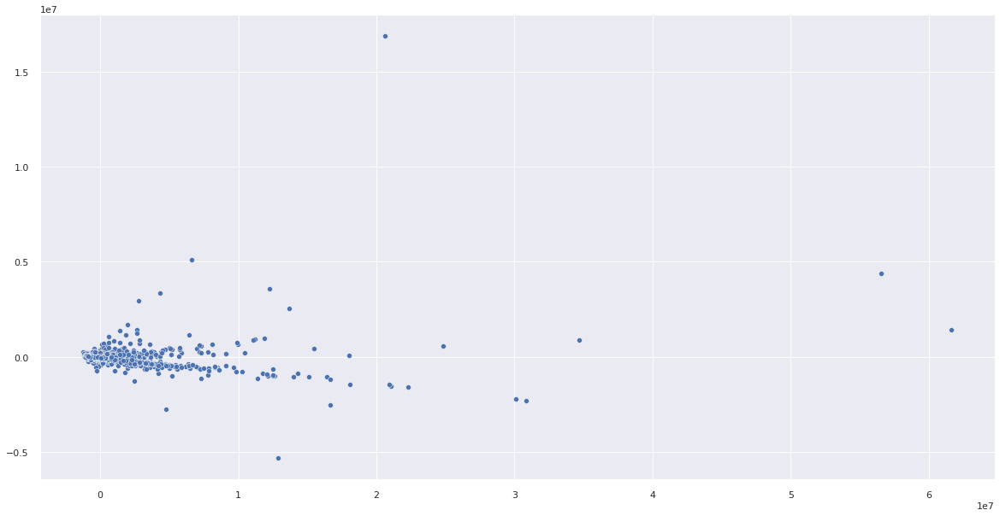

In [ ]:
#plot pca with 2 componets
sns.scatterplot(x=values[:,0], y=values[:,1])

**SCALING**

In [ ]:
#perfrom min max scaling
scaler = MinMaxScaler()
full_scaled = pd.DataFrame(scaler.fit_transform(main_crime_imp_itr), columns = main_crime_imp_itr.columns)

In [ ]:
#view scaled dataframe
full_scaled.head()

,rank,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,Walk_Score,Transit_Score,Bike_Score,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse
0,0.255319,0.158531,0.477565,0.006041,0.053396,0.030303,0.031710,0.010929,0.009570,0.003277,0.34,0.0,0.176796,0.776562,0.141927,0.405358,0.747269,0.024582,0.026987,0.029921
1,0.888611,0.796715,0.925802,0.040714,0.091124,0.040404,0.033660,0.041555,0.027906,0.003277,0.00,0.0,0.000000,0.092848,0.351562,0.545137,0.896003,0.070114,0.013181,0.016765
2,0.081352,0.156709,0.523728,0.008673,0.053396,0.020202,0.032486,0.015138,0.014913,0.003277,0.13,0.0,0.160221,0.769857,0.322917,0.502663,0.694684,0.021501,0.027368,0.028135
3,0.276596,0.932129,0.023875,0.018265,0.034532,0.020202,0.028821,0.024913,0.009259,0.003277,0.07,0.0,0.000000,0.990819,0.365885,0.572167,0.897795,0.011887,0.009690,0.034462
4,0.260325,0.927351,0.084734,0.004592,0.015669,0.030303,0.031045,0.009948,0.006584,0.003277,0.67,0.0,0.292818,0.993914,0.319010,0.579117,0.826981,0.048372,0.054432,0.052155


**LIST OF LATENT VARIABLES**

- Walk_Score
- Transit_Score
- Bike_Score
- Violent Crime
- Property Crime
- Zip_code_Rank_to_live
- Zip_code_Rank_Families
- Zip_code_Rank_schools
- Zip_code_Rank_Diverse
- possible profit(zestimate-price)

# **CLUSTERING**

**KMEANS ON THE ENTIRE DATASER FOR THE FIRST TIME TO CHECK IF WE CAN FIND ANY GOOD CLUSTERS**

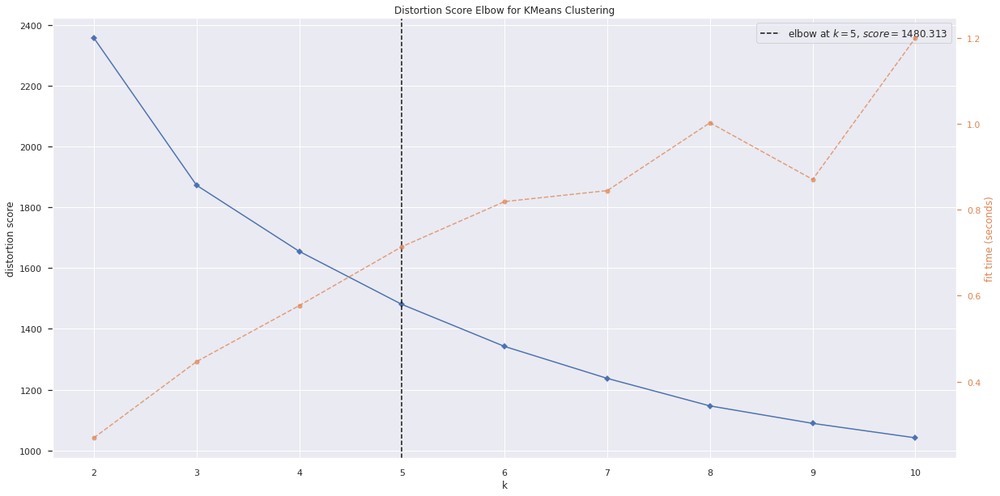

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,11))
visualizer.fit(full_scaled.values)        # Fit the data to the visualizer
visualizer.show()

In [ ]:
# create tmp dataframe
tmp = full_scaled

In [ ]:
# Re-Train K means model with k=5
kmeans_model_new = KMeans(n_clusters = 5, init='k-means++',max_iter=400,random_state=42)

kmeans_model_new.fit_predict(tmp.values)

array([2, 1, 2, ..., 2, 4, 4], dtype=int32)

In [ ]:
# Add "clusters" to customers data
tmp["clusters"] = kmeans_model_new.labels_

In [ ]:
#add the cluster id to the final dataframe without scaled values
main_crime_imp_knn['clusters'] = kmeans_model_new.labels_

In [ ]:
#view the dataframe
main_crime_imp_knn.head()

,rank,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,...,Transit_Score,Bike_Score,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse,clusters
0,205.0,29.599431,-98.254866,296000.0,3.0,3.0,2294.0,2.701000e+05,2024.000000,0.0,...,0.0,32.0,78108.0,12.9,18.3,1772.0,1905.0,2182.0,2659.0,2
1,711.0,44.306944,-73.950285,1995000.0,5.0,4.0,3000.0,1.641767e+06,6914.333333,0.0,...,0.0,0.0,12946.0,29.0,36.4,6586.0,8171.0,442.0,471.0,1
2,66.0,29.557442,-95.751786,425000.0,3.0,2.0,2575.0,4.360000e+05,2967.000000,0.0,...,0.0,29.0,77469.0,26.8,30.9,70.0,1481.0,2230.0,2362.0,2
3,222.0,47.427678,-122.855113,895000.0,2.0,2.0,1248.0,9.078493e+05,1969.000000,0.0,...,0.0,0.0,98528.0,30.1,39.9,6644.0,158.0,2.0,4291.0,3
4,209.0,47.317560,-119.555181,225000.0,1.0,3.0,2053.0,2.314000e+05,1497.000000,0.0,...,0.0,53.0,98823.0,26.5,40.8,4352.0,5179.0,5641.0,6357.0,3


In [ ]:
#dtypes
main_crime_imp_knn.dtypes

rank                      float64
latitude                  float64
longitude                 float64
price                     float64
bathrooms                 float64
bedrooms                  float64
area                      float64
zestimate                 float64
rent_zestimate            float64
days_on_zillow            float64
Walk_Score                float64
Transit_Score             float64
Bike_Score                float64
Zipcode                   float64
Violent Crime             float64
Property Crime            float64
Zip_code_Rank_to_live     float64
Zip_code_Rank_Families    float64
Zip_code_Rank_schools     float64
Zip_code_Rank_Diverse     float64
clusters                    int32
dtype: object

In [ ]:
#selectiong few columns for pairplot
ploting_df = main_crime_imp_knn.drop(columns=['rank','latitude','longitude','days_on_zillow'])

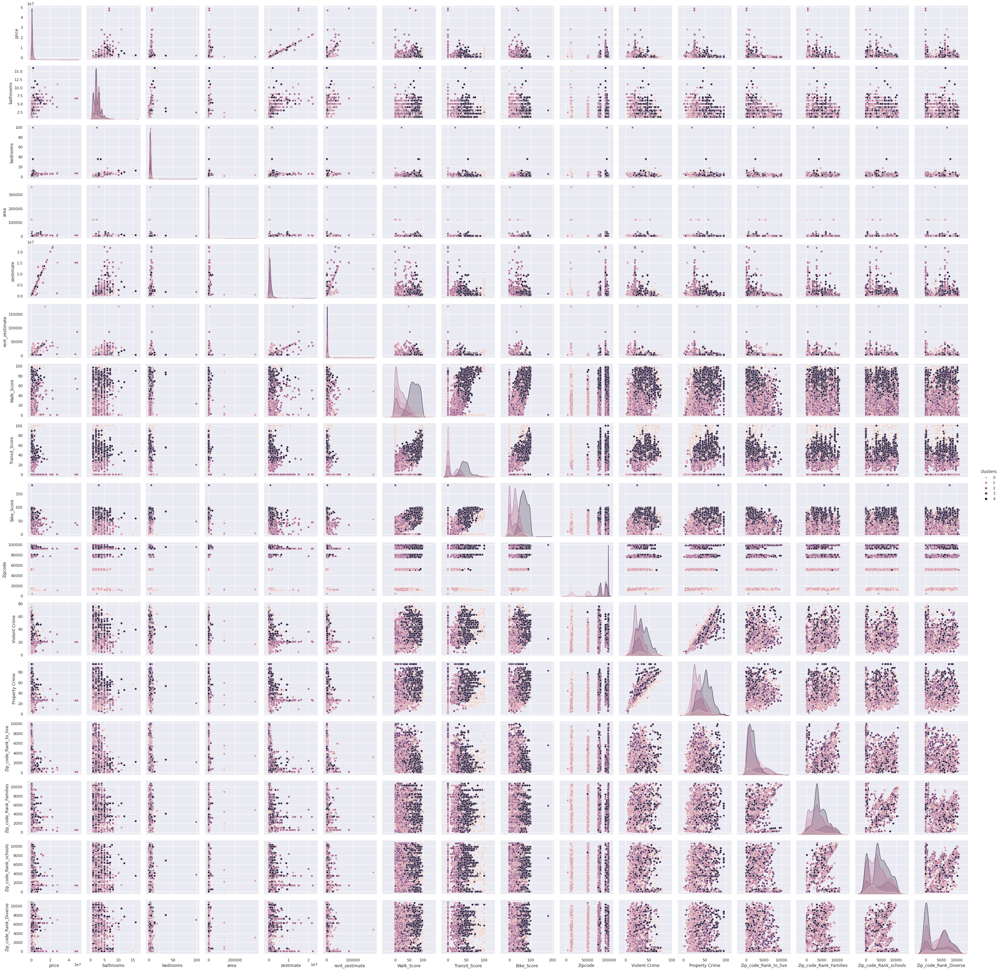

In [ ]:
#pair plot with features and clusters
sns.pairplot(ploting_df, hue='clusters')

From the above, we are not able to get into any conclusions so the better way is to do fractral clustering based on different objectives and arrive at the required cluster.

Now, We are going to Cluster based on different objectives to arrive the golden cluster
First, we would cluster by Walk Score, Bike Score, Transit_Score such that we can get the cluster which has various amenities(restaurants, coffee shops, grocery stores, schools, parks) nearby to our needs

In [ ]:
#walkable info
Walkable_info=full_scaled.loc[:,['Walk_Score','Transit_Score','Bike_Score']]

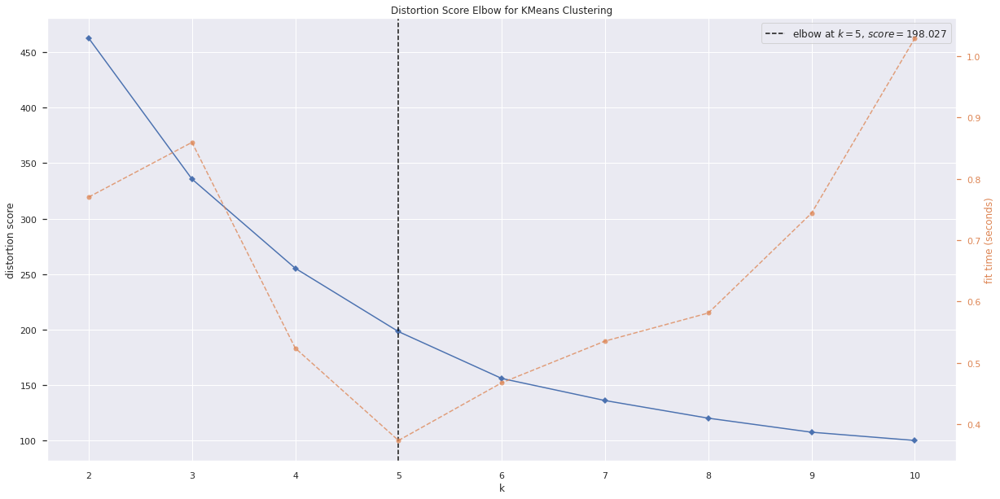

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,11))
 
visualizer.fit(Walkable_info.values)        # Fit the data to the visualizer
visualizer.show()

In [ ]:
# Re-Train K means model with k=5
kmeans_model_new = KMeans(n_clusters = 5, init='k-means++',max_iter=400,random_state=42)

kmeans_model_new.fit_predict(Walkable_info.values)

array([2, 1, 1, ..., 0, 3, 3], dtype=int32)

In [ ]:
print("silhouette_score -", silhouette_score(Walkable_info, kmeans_model_new.labels_, metric='euclidean'))
print("calinski_harabasz_score -", calinski_harabasz_score(Walkable_info, kmeans_model_new.labels_))
print("davies_bouldin_score -", davies_bouldin_score(Walkable_info, kmeans_model_new.labels_))

silhouette_score - 0.4462834978243545
calinski_harabasz_score - 6237.121418336873
davies_bouldin_score - 0.7932156500561465


In [ ]:
Walkable_info["walk_clusters"] = kmeans_model_new.labels_

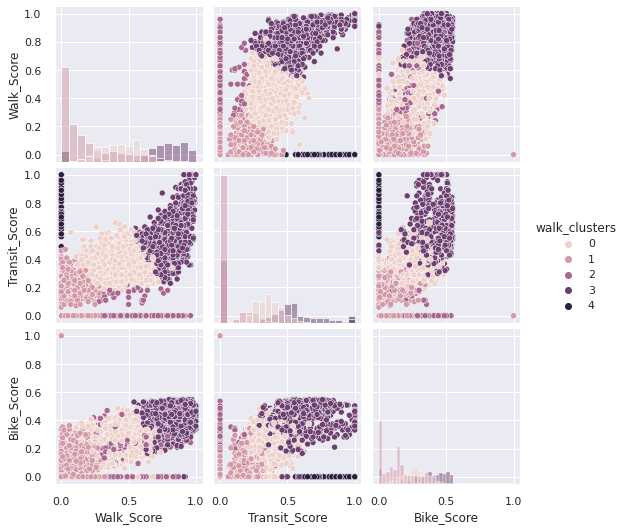

In [ ]:
sns.pairplot(Walkable_info, hue='walk_clusters',diag_kind="hist")

In [ ]:
Walkable_info.groupby('walk_clusters')['Walk_Score'].count()

walk_clusters
0    1480
1    2189
2     751
3    1226
4     118
Name: Walk_Score, dtype: int64

**From the above, i'm going to pick the cluster 1,2 since, they seem good for further cluster**

In [ ]:
walk_cluster = Walkable_info[(Walkable_info['walk_clusters'] == 0) | (Walkable_info['walk_clusters'] == 3)]

In [ ]:
walk_cluster.describe()

,Walk_Score,Transit_Score,Bike_Score,walk_clusters
count,2706.000000,2706.000000,2706.000000,2706.000000
mean,0.608647,0.452890,0.323327,1.359202
std,0.219062,0.161986,0.126629,1.493653
min,0.070000,0.160000,0.000000,0.000000
25%,0.430000,0.340000,0.248619,0.000000
50%,0.610000,0.420000,0.325967,0.000000
75%,0.790000,0.530000,0.414365,3.000000
max,1.000000,1.000000,0.546961,3.000000


**Now Perfrom Cultering Based on Violent Crime & Property Crime on top of Walk CLuster to get another Cluster**

In [ ]:
Safety_df=full_scaled.loc[:,['Violent Crime','Property Crime']]

In [ ]:
#merge safety_df with walk_cluster
Safety = pd.merge(walk_cluster,Safety_df,left_index=True,right_index=True)

In [ ]:
Safety.describe()

,Walk_Score,Transit_Score,Bike_Score,walk_clusters,Violent Crime,Property Crime
count,2706.000000,2706.000000,2706.000000,2706.000000,2706.000000,2706.000000
mean,0.608647,0.452890,0.323327,1.359202,0.436443,0.636663
std,0.219062,0.161986,0.126629,1.493653,0.170838,0.120818
min,0.070000,0.160000,0.000000,0.000000,0.019531,0.328904
25%,0.430000,0.340000,0.248619,0.000000,0.302083,0.534326
50%,0.610000,0.420000,0.325967,0.000000,0.403646,0.638581
75%,0.790000,0.530000,0.414365,3.000000,0.549479,0.723530
max,1.000000,1.000000,0.546961,3.000000,1.000000,1.000000


In [ ]:
#select only the necessary objective function to cluster drop others
Safety_clus = Safety.drop(columns=['Walk_Score','Transit_Score','Bike_Score','walk_clusters'])

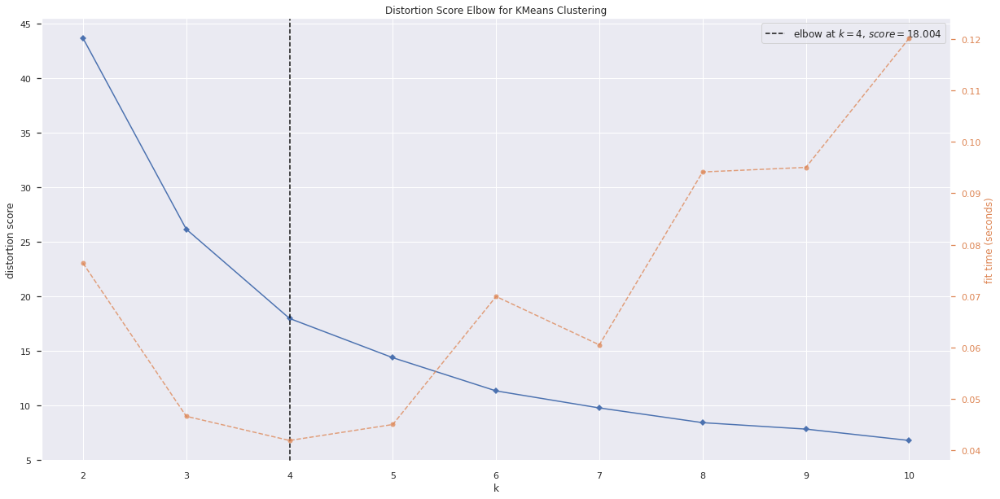

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
from yellowbrick.cluster import KElbowVisualizer

km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,11))
 
visualizer.fit(Safety_clus)        # Fit the data to the visualizer
visualizer.show()

In [ ]:
# Re-Train K means model with k=4
kmeans_model_new = KMeans(n_clusters = 4, init='k-means++',max_iter=400,random_state=42)

kmeans_model_new.fit_predict(Safety_clus)

array([1, 1, 1, ..., 3, 3, 3], dtype=int32)

In [ ]:
print("silhouette_score -", silhouette_score(Safety_clus, kmeans_model_new.labels_, metric='euclidean'))
print("calinski_harabasz_score -", calinski_harabasz_score(Safety_clus, kmeans_model_new.labels_))
print("davies_bouldin_score -", davies_bouldin_score(Safety_clus, kmeans_model_new.labels_))

silhouette_score - 0.47458581046535314
calinski_harabasz_score - 5023.873442857648
davies_bouldin_score - 0.713539528256791


In [ ]:
#append cluster 
Safety_clus['safety_clusters'] = kmeans_model_new.labels_

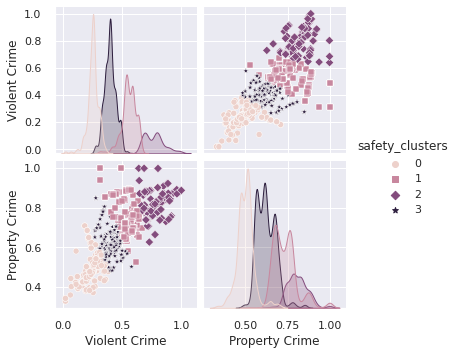

In [ ]:
sns.pairplot(Safety_clus, hue='safety_clusters',markers=["o", "s", "D","*"])

In [ ]:
Safety_clus.groupby('safety_clusters')['Violent Crime'].count()

safety_clusters
0    768
1    706
2    294
3    938
Name: Violent Crime, dtype: int64

**from the above plot we can select cluster 0 and 2 which has significent less violent crime and property crime**

In [ ]:
Safety_cluster = Safety_clus[(Safety_clus['safety_clusters'] == 0) | (Safety_clus['safety_clusters'] == 3)]

In [ ]:
Safety_cluster.describe()

,Violent Crime,Property Crime,safety_clusters
count,1706.000000,1706.000000,1706.000000
mean,0.330616,0.566832,1.649472
std,0.087038,0.080770,1.492972
min,0.019531,0.328904,0.000000
25%,0.255208,0.508841,0.000000
50%,0.328125,0.563672,3.000000
75%,0.398438,0.618502,3.000000
max,0.578125,0.856359,3.000000


**Now Finally we can Perfrom Cultering Based on Profit on top of Safety CLuster to get Golden Cluster**

Since the dataset does not contain selling price, for the sake of analysis, we are trying to get the profit by subracting the zestimate value with listing price.

Zestimate is based on the existing market value.

From Customer or investor perspective if the value of list price is less than selling price then it may be a profitable assest. 

In [ ]:
# get the price and zestimate value to calculate profit
priceinfo_df=full_scaled.loc[:,['zestimate','price']]

In [ ]:
#now calculate profit
priceinfo_df['profit'] = main_crime_imp_itr['zestimate'] - main_crime_imp_itr['price']

In [ ]:
#perfrom min max scaling
scaler = MinMaxScaler()
profit_scaled = scaler.fit_transform(np.array(priceinfo_df['profit'].values).reshape(-1,1))
priceinfo_df['profit']=profit_scaled

In [ ]:
#merge priceinfo_df with Safety_cluster
Profit_df = pd.merge(priceinfo_df,Safety_cluster,left_index=True,right_index=True)

In [ ]:
Profit_df

,zestimate,price,profit,Violent Crime,Property Crime,safety_clusters
12,0.056540,0.042551,0.818097,0.337240,0.780677,3
16,0.016078,0.005490,0.824953,0.403646,0.613096,3
21,0.039787,0.026510,0.821994,0.248698,0.498802,0
23,0.072935,0.071429,0.794246,0.397135,0.613869,3
37,0.018760,0.011812,0.818621,0.403646,0.613096,3
...,...,...,...,...,...,...
5756,0.010369,0.004796,0.819024,0.277344,0.542821,0
5760,0.021097,0.013878,0.818339,0.196615,0.503435,0
5761,0.009600,0.004286,0.818860,0.389323,0.526603,3
5762,0.025857,0.017347,0.818887,0.403646,0.613096,3


In [ ]:
#select only the necessary objective function to cluster drop others
Profit_clus = Profit_df.drop(columns=['Violent Crime','Property Crime','safety_clusters','zestimate','price'])

In [ ]:
Profit_clus.head()

,profit
12,0.818097
16,0.824953
21,0.821994
23,0.794246
37,0.818621


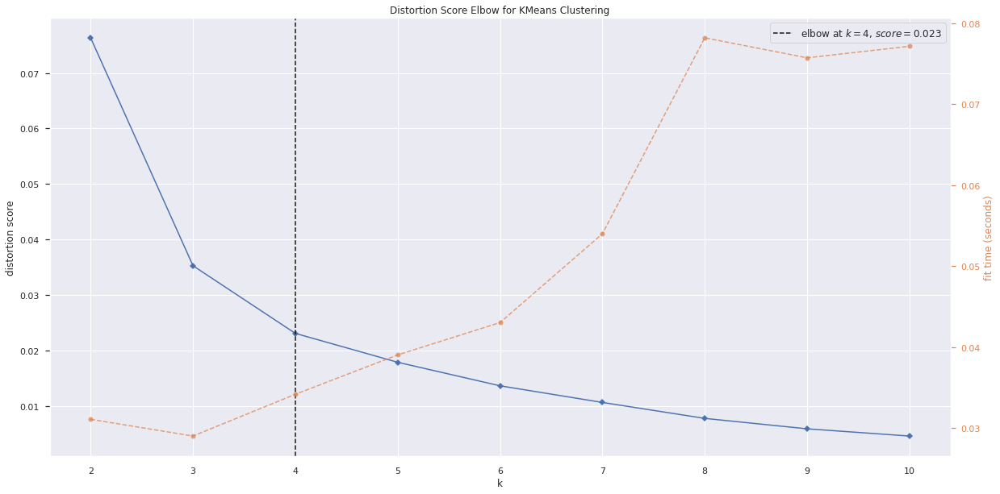

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
from yellowbrick.cluster import KElbowVisualizer

km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,11))
 
visualizer.fit(Profit_clus)        # Fit the data to the visualizer
visualizer.show()

In [ ]:
# Re-Train K means model with k=5
kmeans_model_new = KMeans(n_clusters = 4, init='k-means++',max_iter=400,random_state=42)

kmeans_model_new.fit_predict(Profit_clus)

array([0, 0, 0, ..., 0, 0, 3], dtype=int32)

In [ ]:
print("silhouette_score -", silhouette_score(Profit_clus, kmeans_model_new.labels_, metric='euclidean'))
print("calinski_harabasz_score -", calinski_harabasz_score(Profit_clus, kmeans_model_new.labels_))
print("davies_bouldin_score -", davies_bouldin_score(Profit_clus, kmeans_model_new.labels_))

silhouette_score - 0.7497966152502136
calinski_harabasz_score - 4435.595988114643
davies_bouldin_score - 0.4405619648704372


In [ ]:
#append cluster 
Profit_clus['profit_clusters'] = kmeans_model_new.labels_

<AxesSubplot:xlabel='profit_clusters', ylabel='profit'>

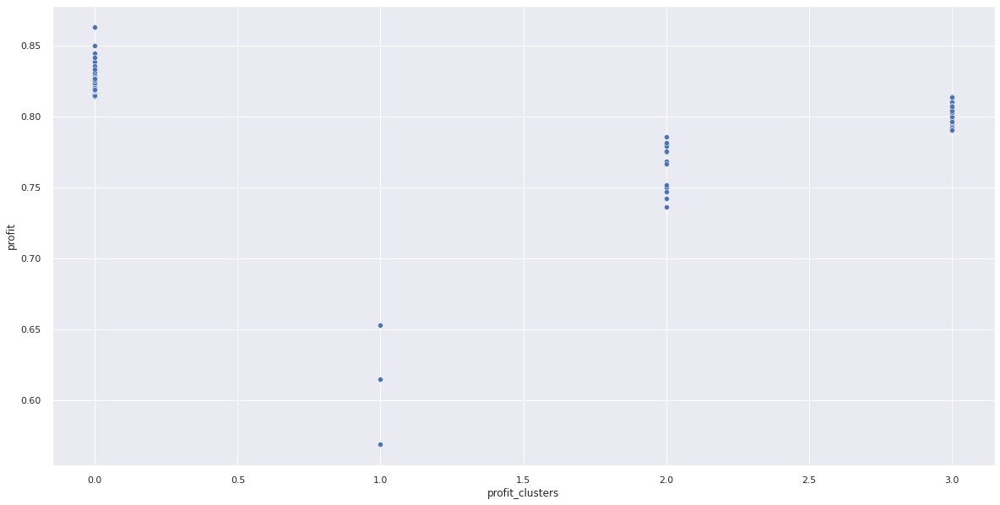

In [ ]:
sns.scatterplot(data=Profit_clus, x="profit_clusters", y="profit")

In [ ]:
Profit_clus.groupby('profit_clusters')['profit'].count()

profit_clusters
0    1563
1       3
2      14
3     126
Name: profit, dtype: int64

**let's select cluster 0 which might have higher possible to increase during the timeperiod**

In [ ]:
profit_cluster = Profit_clus[(Profit_clus['profit_clusters'] == 0)]

In [ ]:
profit_cluster.describe()

,profit,profit_clusters
count,1563.000000,1563.0
mean,0.819588,0.0
std,0.002765,0.0
min,0.814131,0.0
25%,0.818621,0.0
50%,0.819137,0.0
75%,0.820376,0.0
max,0.863188,0.0


In [ ]:
#merge to get final cluster
final_cluster = pd.merge(main_crime_imp_itr,profit_cluster,left_index=True,right_index=True)

In [ ]:
final_cluster

,rank,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,...,Bike_Score,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse,profit,profit_clusters
12,253.0,47.676898,-122.292611,2085000.0,4.0,4.0,4000.0,2.068100e+06,5284.0,0.0,...,82.0,98115.0,27.9,66.9,920.0,1865.0,3404.0,6723.0,0.818097,0
16,423.0,37.298259,-121.934681,269000.0,2.0,2.0,1440.0,4.730683e+05,2914.0,38.0,...,79.0,95128.0,33.0,45.2,489.0,3867.0,4259.0,6089.0,0.824953,0
21,205.0,37.409136,-121.851067,1299000.0,2.0,4.0,1383.0,1.407700e+06,3599.0,8.0,...,49.0,95132.0,21.1,30.4,3133.0,4709.0,6273.0,6320.0,0.821994,0
37,447.0,37.312417,-121.939481,578800.0,2.0,2.0,922.0,5.788050e+05,2596.0,46.0,...,48.0,95128.0,33.0,45.2,489.0,3867.0,4259.0,6089.0,0.818621,0
40,116.0,32.781070,-117.146380,1475000.0,4.0,3.0,2124.0,1.380501e+06,4078.0,1.0,...,14.0,92108.0,33.8,43.6,1320.0,2773.0,3495.0,6140.0,0.815689,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5750,536.0,39.746457,-104.996700,349900.0,2.0,2.0,993.0,3.499000e+05,2316.0,14.0,...,93.0,80202.0,36.4,57.2,1043.0,9283.0,13.0,193.0,0.818621,0
5756,479.0,37.276635,-121.863132,235000.0,2.0,2.0,1100.0,2.480000e+05,2882.0,56.0,...,52.0,95136.0,23.3,36.1,435.0,5214.0,5351.0,5356.0,0.819024,0
5760,666.0,47.511643,-122.158842,680000.0,3.0,3.0,1770.0,6.709000e+05,2926.0,0.0,...,47.0,98059.0,17.1,31.0,1097.0,1609.0,2127.0,3388.0,0.818339,0
5761,637.0,29.503986,-98.305032,210000.0,2.0,4.0,1576.0,2.177000e+05,1680.0,0.0,...,46.0,78109.0,31.9,34.0,925.0,6440.0,6930.0,110.0,0.818860,0


In [ ]:
final_cluster.describe()

,rank,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,...,Bike_Score,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse,profit,profit_clusters
count,1563.000000,1563.000000,1563.000000,1.563000e+03,1563.000000,1563.000000,1563.000000,1.563000e+03,1563.000000,1563.000000,...,1563.000000,1563.000000,1563.000000,1563.000000,1563.000000,1563.000000,1563.000000,1563.000000,1563.000000,1563.0
mean,352.883557,37.628628,-112.444092,8.841398e+05,2.377476,3.023566,1735.397809,9.153060e+05,3352.418686,17.816478,...,55.213052,84701.589251,27.329194,39.444206,1784.632507,4009.209090,4215.931960,4006.632911,0.819588,0.0
std,229.102176,4.435509,12.030305,7.543786e+05,1.031357,1.206370,1280.048703,7.816854e+05,2032.705383,45.485269,...,22.294933,19431.838667,6.609660,10.348990,1439.923190,2128.059827,2726.586287,3125.406418,0.002765,0.0
min,1.000000,27.660508,-123.536561,2.490000e+04,0.699923,0.000000,-8130.264637,3.520000e+04,461.000000,-17.000000,...,0.000000,10010.000000,3.500000,8.400000,2.000000,1.000000,1.000000,-599.579542,0.814131,0.0
25%,143.000000,32.982778,-121.849935,4.200000e+05,2.000000,2.000000,1083.000000,4.614066e+05,2356.000000,1.000000,...,43.000000,80210.000000,21.600000,31.700000,742.000000,2643.000000,2209.000000,193.000000,0.818621,0.0
50%,342.000000,37.312417,-117.169716,7.000000e+05,2.000000,3.000000,1519.000000,7.264587e+05,2966.000000,7.000000,...,56.000000,92111.000000,27.200000,38.900000,1433.000000,3501.000000,3931.000000,4755.965993,0.819137,0.0
75%,537.500000,39.746457,-104.959840,1.100000e+06,3.000000,4.000000,2093.500000,1.164920e+06,3810.500000,21.000000,...,71.000000,95124.000000,32.600000,46.200000,2390.000000,5248.396124,5858.000000,6319.500000,0.820376,0.0
max,800.000000,48.778968,-72.898505,1.200000e+07,12.000000,12.000000,31363.000000,1.343640e+07,44086.000000,978.000000,...,99.000000,99362.000000,43.600000,76.700000,7629.000000,9637.000000,10646.000000,10634.000000,0.863188,0.0


**Now, We have arrived at our golden cluster**

In [ ]:
#write to csv
final_cluster.to_csv('final_cluster.csv')

# **Visualization**

Alert! from version 0.1.36. After importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
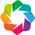

In [ ]:
# importing Autoviz class
from autoviz.AutoViz_Class import AutoViz_Class#Instantiate the AutoViz class
AV = AutoViz_Class()

Shape of your Data Set loaded: (1563, 23)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  20
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  1
    Number of Columns to Delete =  1
    22 Predictors classified...
        2 variables removed since they were ID or low-information variables
    List of variables removed: ['Unnamed: 0', 'profit_clusters']

################ Regression VISUALIZATION Started #####################
Data Set Shape: 1563 rows, 21 cols
Data Set columns info:
* rank: 0 nulls, 731 unique vals, most common: {103.0: 6, 520.0: 6}
* latitude: 0 nulls, 1414 

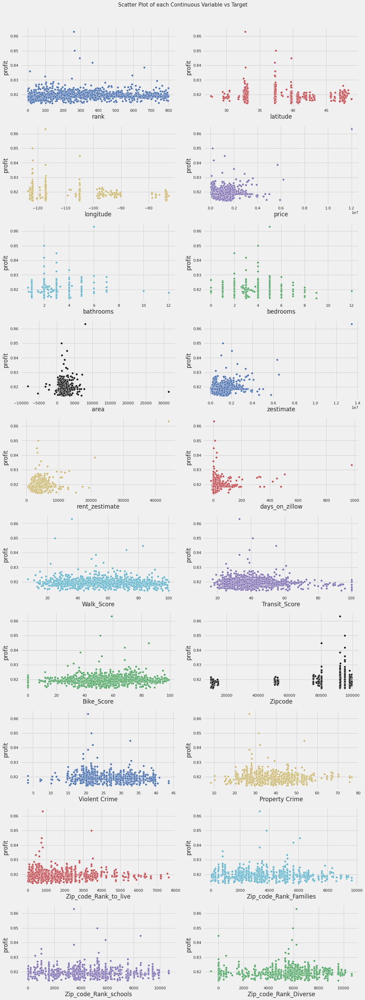

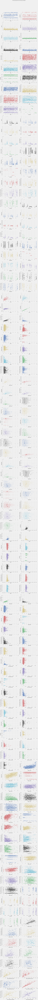

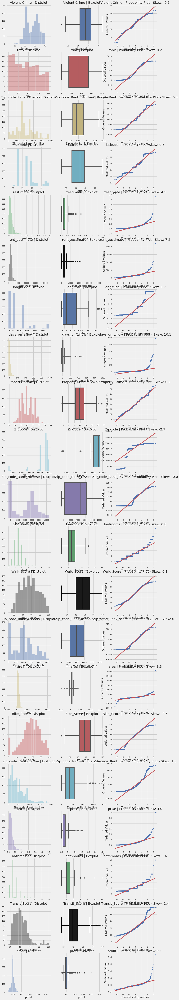

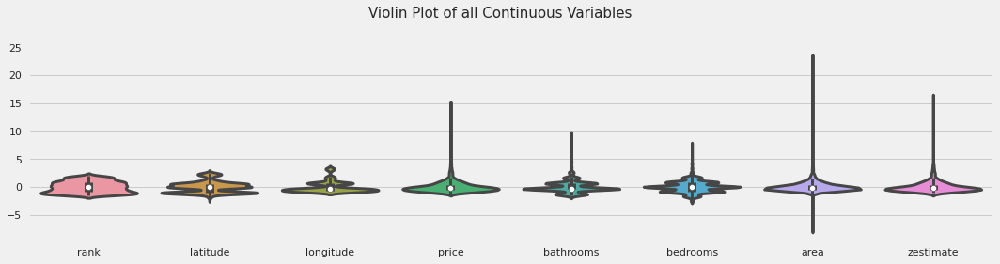

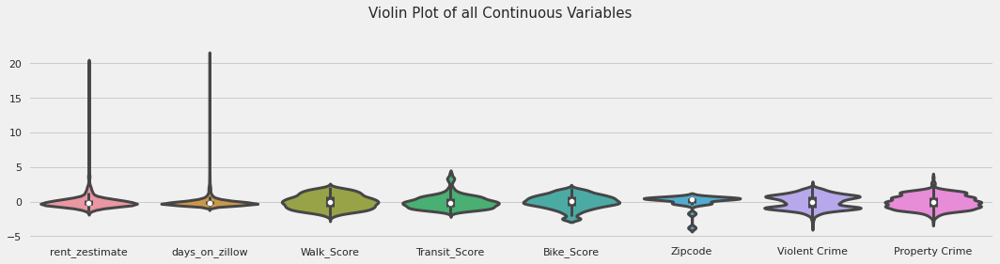

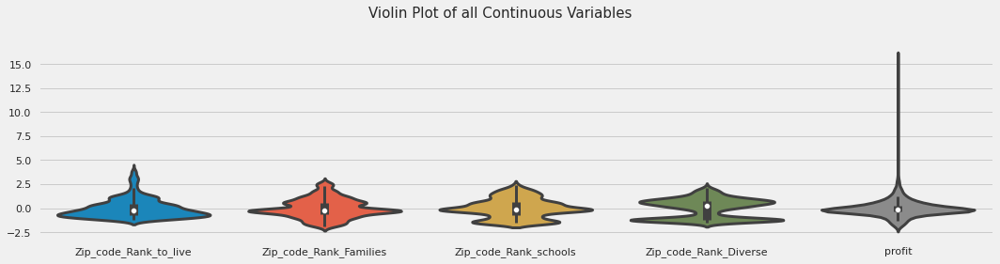

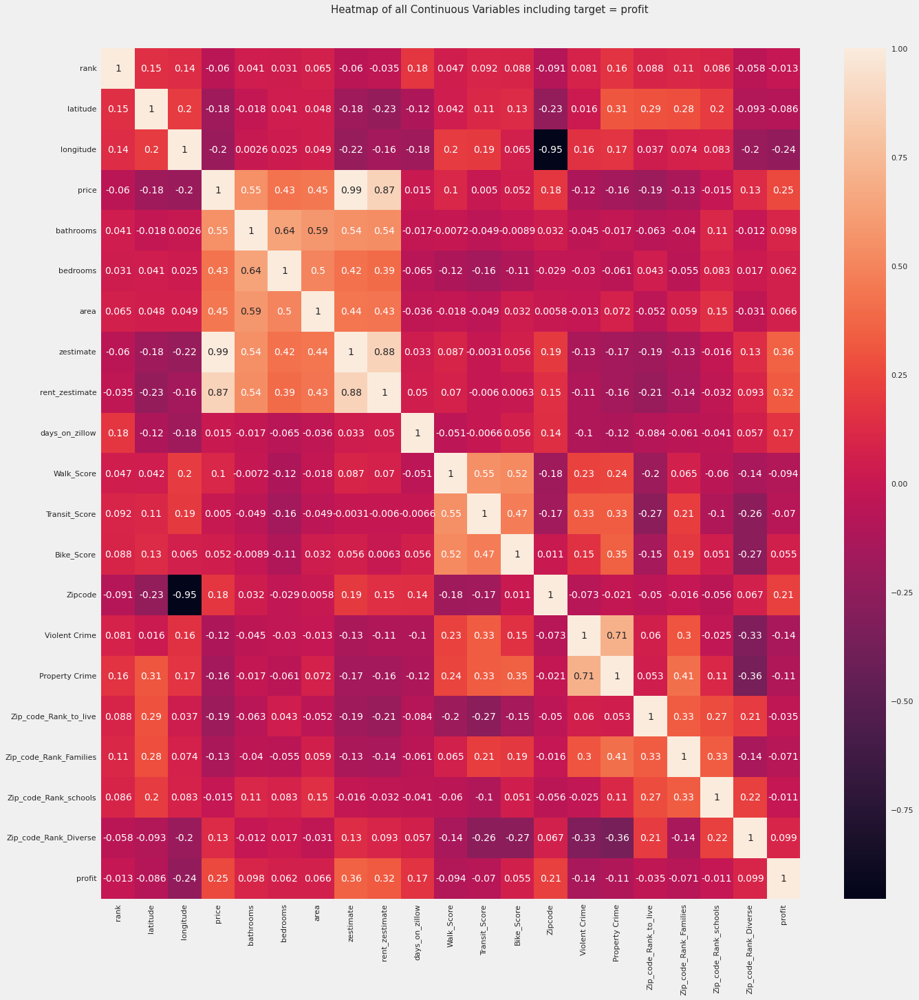

In [ ]:
df = AV.AutoViz('/content/final_cluster.csv', depVar='profit', verbose=1)

# **REGRESSION**

**We are going to perform Price Prediction**

### **Train Test Split**

In [ ]:
Final_X = final_cluster.drop(columns=['price'])
y = final_cluster['price']

In [ ]:
#perfrom train test split
X_train, X_test, y_train, y_test = train_test_split(Final_X, y, test_size=0.2, random_state=21)

**VISUALIZE TRAIN TEST SPLIT**

In [ ]:
# train test split visualization
# importing sweetviz
training_date = X_train
training_date['delivery_date']= y_train

testing_data = X_test
testing_data['delivery_date']= y_test

#compare train and test
comparison_report = sv.compare([training_date,'Train'], [testing_data,'Test'])

                                             |          | [  0%]   00:00 -> (? left)


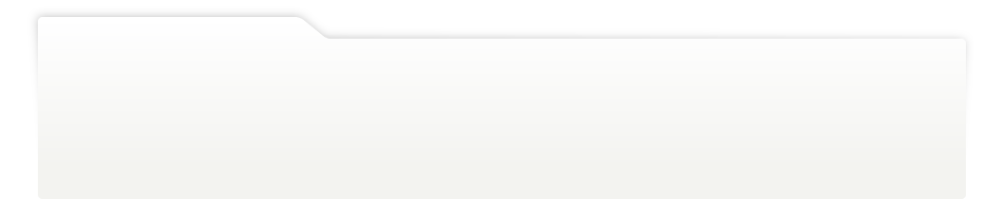
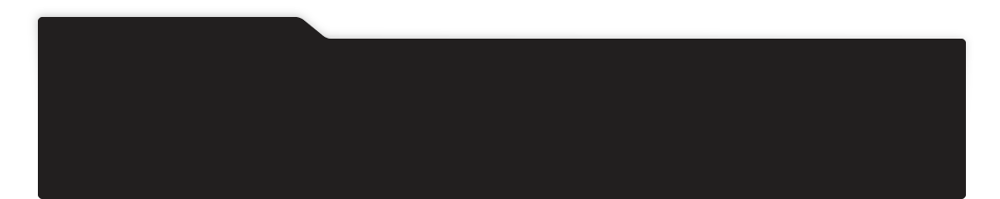
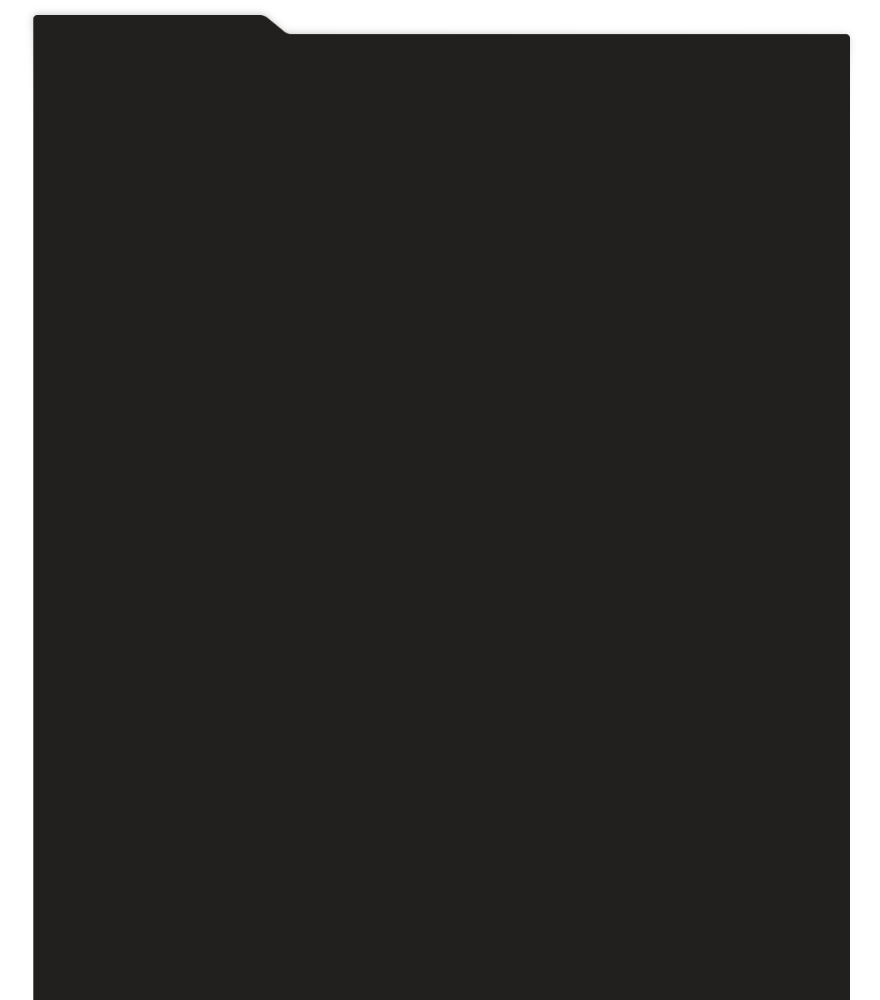
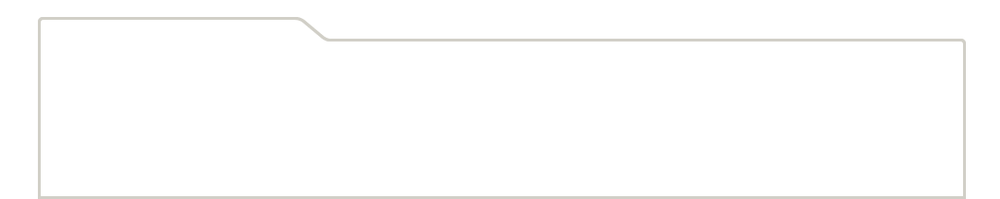
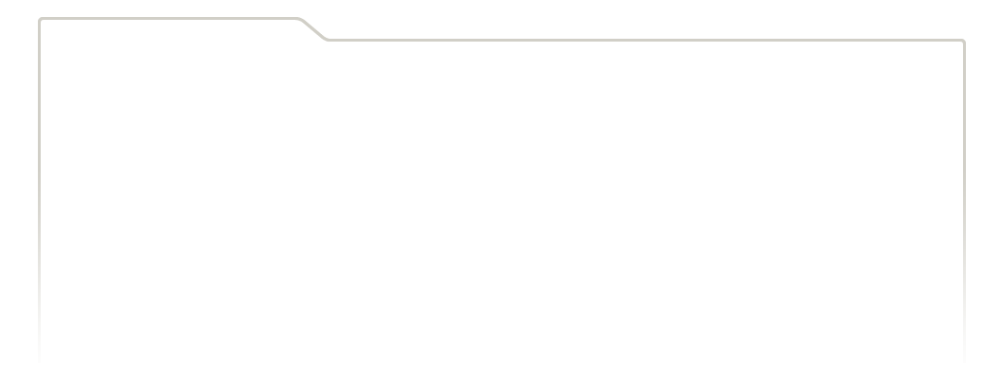
...
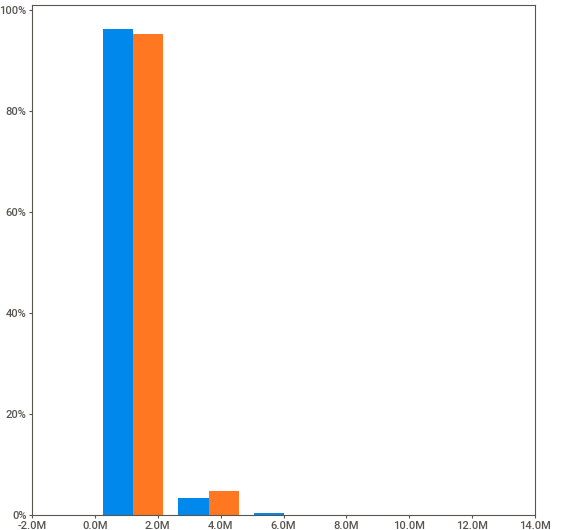
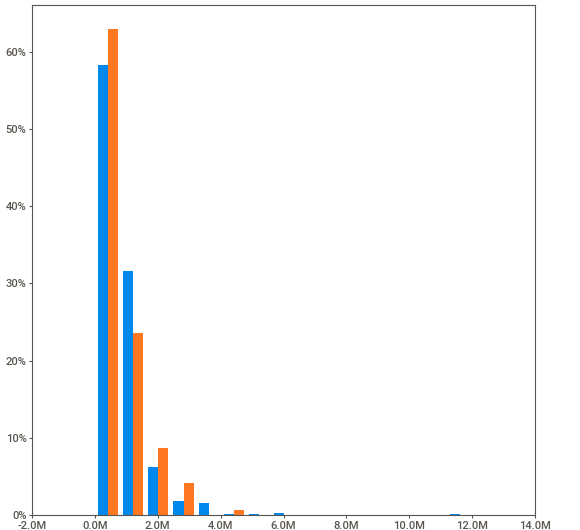
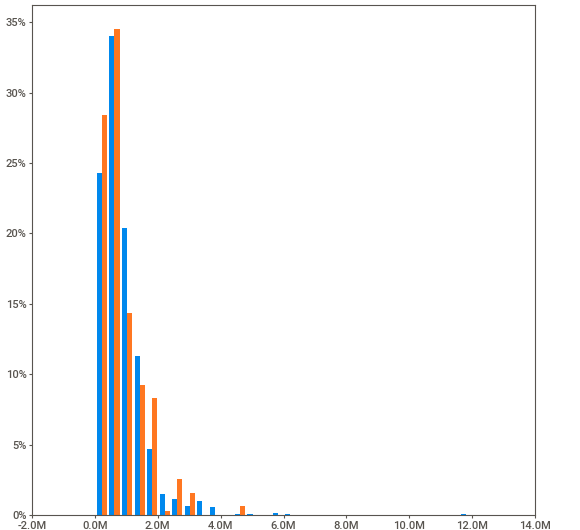
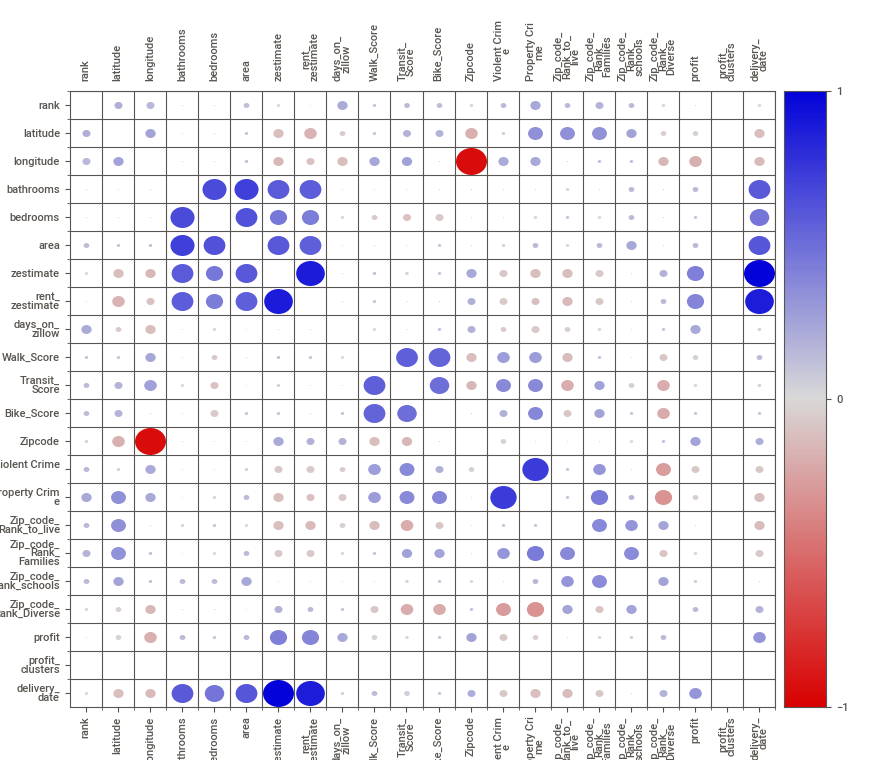
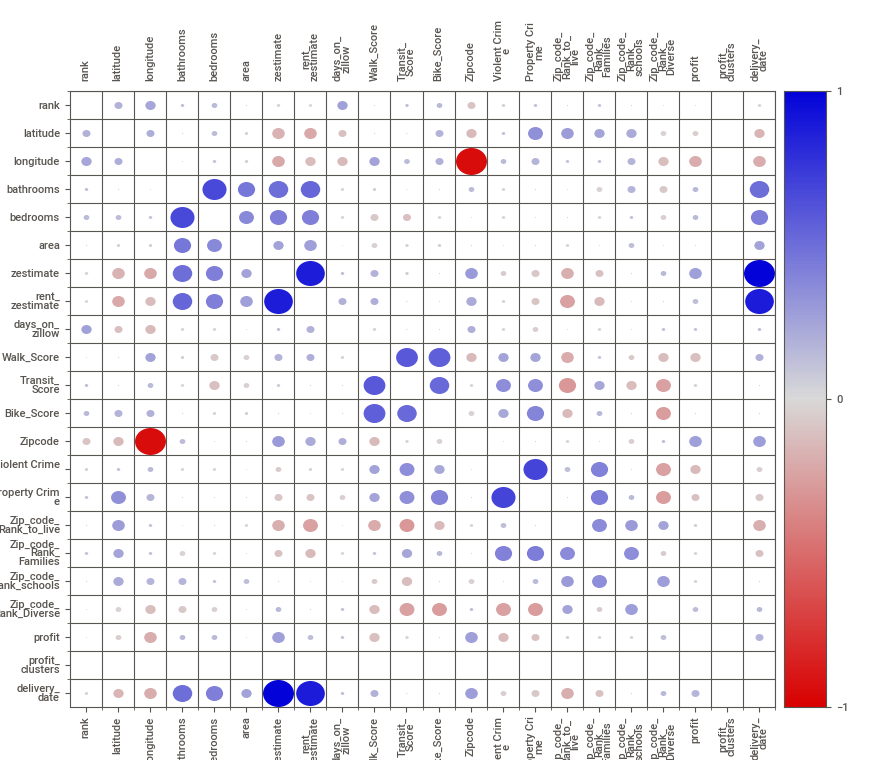

In [ ]:
comparison_report.show_notebook() # Using the default values (w="100%", h=750, layout="vertical"), all can be overridden in an INI, see below)

### **DIFFERENT FEATURE SELECTION METHODS**

**Pearson Correlation**

In [ ]:
def cor_selector(X, y,num_feats):
    cor_list = []
    feature_name = X.columns.tolist()
    # calculate the correlation with y for each feature
    cor_list = X.corrwith(y)
    # replace NaN with 0
    cor_list = [0 if np.isnan(i) else i for i in cor_list]
    # feature name
    cor_feature = X.iloc[:,np.argsort(np.abs(cor_list))[-num_feats:]].columns.tolist()
    # feature selection? 0 for not select, 1 for select
    cor_support = [True if i in cor_feature else False for i in feature_name]
    return cor_support, cor_feature

In [ ]:
num_feats=10
cor_support, cor_feature = cor_selector(Final_X, y,num_feats)
print(str(len(cor_feature)), 'selected features')

10 selected features


In [ ]:
for x in cor_feature:
  print(x)

Zipcode
latitude
Zip_code_Rank_to_live
longitude
profit
bedrooms
area
bathrooms
rent_zestimate
zestimate


**CHI-SQUARED**

In [ ]:
#normalize prior CHI-SQUARE
X_norm = MinMaxScaler().fit_transform(Final_X)

chi_selector = SelectKBest(chi2, k=num_feats)
chi_selector.fit(X_norm, round(y))
chi_support = chi_selector.get_support()
chi_feature = Final_X.loc[:,chi_support].columns.tolist()
print(str(len(chi_feature)), 'selected features')

10 selected features


In [ ]:
for x in cor_feature:
  print(x)

Zipcode
latitude
Zip_code_Rank_to_live
longitude
profit
bedrooms
area
bathrooms
rent_zestimate
zestimate


**Recursive Feature Elimination**

In [ ]:
rfe_selector = RFE(estimator=LogisticRegression(), n_features_to_select=num_feats, step=10, verbose=5)
rfe_selector.fit(X_norm, round(y))
rfe_support = rfe_selector.get_support()
rfe_feature = Final_X.loc[:,rfe_support].columns.tolist()
print(str(len(rfe_feature)), 'selected features')

Fitting estimator with 21 features.
Fitting estimator with 11 features.
10 selected features


In [ ]:
rfe_feature

['rank',
 'latitude',
 'longitude',
 'Walk_Score',
 'Bike_Score',
 'Zipcode',
 'Zip_code_Rank_to_live',
 'Zip_code_Rank_Families',
 'Zip_code_Rank_schools',
 'Zip_code_Rank_Diverse']

**Lasso: SelectFromModel**

In [ ]:
embeded_lr_selector = SelectFromModel(LogisticRegression(penalty="l2"), max_features=num_feats)
embeded_lr_selector.fit(X_norm,round(y))

embeded_lr_support = embeded_lr_selector.get_support()
embeded_lr_feature = Final_X.loc[:,embeded_lr_support].columns.tolist()
print(str(len(embeded_lr_feature)), 'selected features')

10 selected features


In [ ]:
embeded_lr_feature

['rank',
 'latitude',
 'longitude',
 'Walk_Score',
 'Bike_Score',
 'Violent Crime',
 'Zip_code_Rank_to_live',
 'Zip_code_Rank_Families',
 'Zip_code_Rank_schools',
 'Zip_code_Rank_Diverse']

**Tree-based: SelectFromModel**

In [ ]:
embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=100), max_features=num_feats)
embeded_rf_selector.fit(Final_X, round(y))

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = Final_X.loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features')

10 selected features


In [ ]:
embeded_rf_feature

['rank',
 'latitude',
 'longitude',
 'area',
 'zestimate',
 'rent_zestimate',
 'Walk_Score',
 'Transit_Score',
 'Bike_Score',
 'profit']

**COMBINE ALL METHODS AND CHOOSE TOP N FEATURES**

In [ ]:
feature_name=Final_X.columns
feature_name

Index(['rank', 'latitude', 'longitude', 'bathrooms', 'bedrooms', 'area',
       'zestimate', 'rent_zestimate', 'days_on_zillow', 'Walk_Score',
       'Transit_Score', 'Bike_Score', 'Zipcode', 'Violent Crime',
       'Property Crime', 'Zip_code_Rank_to_live', 'Zip_code_Rank_Families',
       'Zip_code_Rank_schools', 'Zip_code_Rank_Diverse', 'profit',
       'profit_clusters'],
      dtype='object')

In [ ]:
# put all selection together
feature_selection_df = pd.DataFrame({'Feature':feature_name, 'Pearson':cor_support, 'Chi-2':chi_support, 'RFE':rfe_support, 'Logistics':embeded_lr_support,
                                    'Random Forest':embeded_rf_support})
# count the selected times for each feature
feature_selection_df['Total'] = np.sum(feature_selection_df, axis=1)
# display the top 100
feature_selection_df = feature_selection_df.sort_values(['Total','Feature'] , ascending=False)
feature_selection_df.index = range(1, len(feature_selection_df)+1)

In [ ]:
feature_selection_df

,Feature,Pearson,Chi-2,RFE,Logistics,Random Forest,Total
1,longitude,True,True,True,True,True,5
2,latitude,True,True,True,True,True,5
3,rank,False,True,True,True,True,4
4,Zip_code_Rank_to_live,True,True,True,True,False,4
5,Walk_Score,False,True,True,True,True,4
6,zestimate,True,True,False,False,True,3
7,Zip_code_Rank_schools,False,True,True,True,False,3
8,Zip_code_Rank_Families,False,True,True,True,False,3
9,Zip_code_Rank_Diverse,False,True,True,True,False,3
10,Bike_Score,False,False,True,True,True,3


In [ ]:
#select top 13 features
final_features = feature_selection_df[:15]['Feature']

In [ ]:
final_features

1                  longitude
2                   latitude
3                       rank
4      Zip_code_Rank_to_live
5                 Walk_Score
6                  zestimate
7      Zip_code_Rank_schools
8     Zip_code_Rank_Families
9      Zip_code_Rank_Diverse
10                Bike_Score
11            rent_zestimate
12                    profit
13                      area
14                   Zipcode
15             Transit_Score
Name: Feature, dtype: object

In [ ]:
temp = [x for x in Final_X.columns if x not in final_features.values]

In [ ]:
temp

['bathrooms',
 'bedrooms',
 'days_on_zillow',
 'Violent Crime',
 'Property Crime',
 'profit_clusters']

In [ ]:
Final_X = Final_X.drop(columns=temp)

In [ ]:
Final_X

,rank,latitude,longitude,area,zestimate,rent_zestimate,Walk_Score,Transit_Score,Bike_Score,Zipcode,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse,profit
12,253.0,47.676898,-122.292611,4000.0,2.068100e+06,5284.0,76.0,50.0,82.0,98115.0,920.0,1865.0,3404.0,6723.0,0.818097
16,423.0,37.298259,-121.934681,1440.0,4.730683e+05,2914.0,65.0,47.0,79.0,95128.0,489.0,3867.0,4259.0,6089.0,0.824953
21,205.0,37.409136,-121.851067,1383.0,1.407700e+06,3599.0,28.0,33.0,49.0,95132.0,3133.0,4709.0,6273.0,6320.0,0.821994
37,447.0,37.312417,-121.939481,922.0,5.788050e+05,2596.0,43.0,41.0,48.0,95128.0,489.0,3867.0,4259.0,6089.0,0.818621
40,116.0,32.781070,-117.146380,2124.0,1.380501e+06,4078.0,18.0,39.0,14.0,92108.0,1320.0,2773.0,3495.0,6140.0,0.815689
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5750,536.0,39.746457,-104.996700,993.0,3.499000e+05,2316.0,92.0,89.0,93.0,80202.0,1043.0,9283.0,13.0,193.0,0.818621
5756,479.0,37.276635,-121.863132,1100.0,2.480000e+05,2882.0,42.0,48.0,52.0,95136.0,435.0,5214.0,5351.0,5356.0,0.819024
5760,666.0,47.511643,-122.158842,1770.0,6.709000e+05,2926.0,40.0,29.0,47.0,98059.0,1097.0,1609.0,2127.0,3388.0,0.818339
5761,637.0,29.503986,-98.305032,1576.0,2.177000e+05,1680.0,45.0,24.0,46.0,78109.0,925.0,6440.0,6930.0,110.0,0.818860


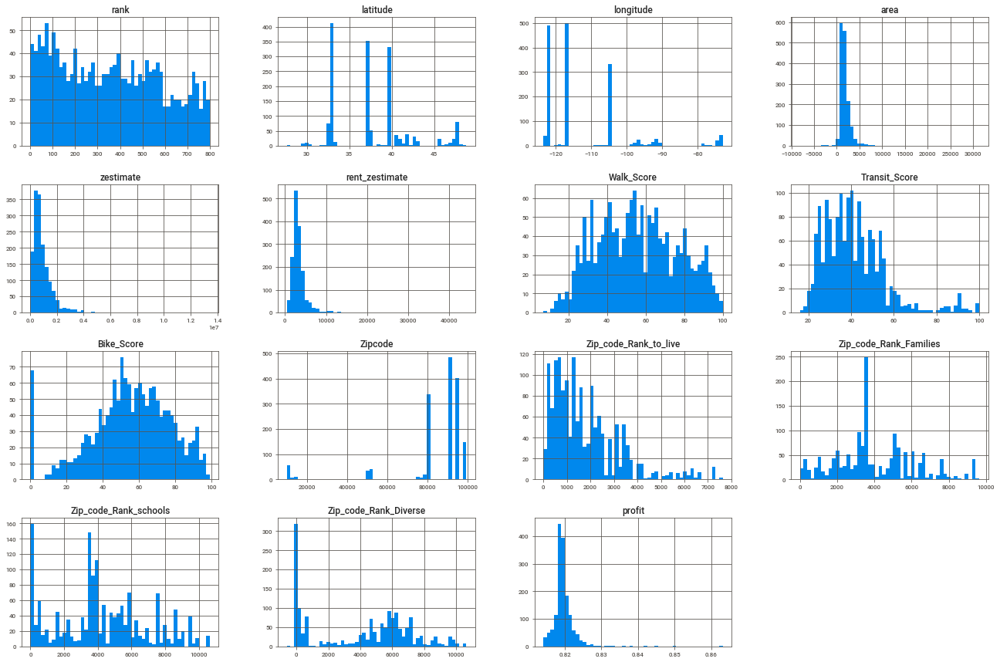

In [ ]:
%matplotlib inline

Final_X.hist(bins=50, figsize=(20,15))
plt.savefig("attribute_histogram_plots")
plt.show()

In [ ]:
print("Skewness: \n",Final_X.skew(),"\n")
print("Kurtosis: \n",Final_X.kurtosis(),"\n")

Skewness: 
 rank                      0.220918
latitude                  0.594189
longitude                 1.651635
area                      8.292305
zestimate                 4.480519
rent_zestimate            7.234255
Walk_Score                0.115189
Transit_Score             1.387355
Bike_Score               -0.483594
Zipcode                  -2.704831
Zip_code_Rank_to_live     1.450897
Zip_code_Rank_Families    0.424178
Zip_code_Rank_schools     0.212034
Zip_code_Rank_Diverse    -0.049650
profit                    5.001363
dtype: float64 

Kurtosis: 
 rank                       -1.122701
latitude                   -0.138623
longitude                   2.426622
area                      187.693366
zestimate                  48.154837
rent_zestimate            113.036629
Walk_Score                 -0.882568
Transit_Score               2.806829
Bike_Score                  0.021096
Zipcode                     7.071732
Zip_code_Rank_to_live       2.310875
Zip_code_Rank_Families     

In [ ]:
def  plot_feature(plot_1, plot_1_title, plot_2, plot_2_title):
  plt.figure(figsize=(12,10))

  plt.subplot(221)
  g = sns.distplot(plot_1)#df_regression['price']
  g.set_title( plot_1_title + "- Distribution", fontsize=15)
  g.set_xlabel("")
  g.set_ylabel("Frequency", fontsize=12)

  plt.subplot(222)
  g1 = sns.distplot(plot_2) #df_regression['freight_value']
  g1.set_title(plot_2_title + "- Distribution", fontsize=15)
  g1.set_xlabel("")
  g1.set_ylabel("Frequency", fontsize=12)

In [ ]:
 #Final_X['profit'] = np.log1p(Final_X['profit'])
 #Final_X['area'] = np.log1p(Final_X['area'])

In [ ]:
#plot_feature(Final_X['profit'], "Profit of the House", Final_X['Walk_Score'], "walk score")

## **Regression Muller Loop**

In [ ]:
names = ["LinearRegression", "RandomForestRegressor", "KNN", "MLPRegressor", "Decision Tree", "Ada Boost Regression", "Ridge"]

In [ ]:
from sklearn.ensemble import AdaBoostRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.linear_model import Ridge
from sklearn.tree import DecisionTreeRegressor

regressors = [
    LinearRegression(),
    RandomForestRegressor(max_depth=7),
    neighbors.KNeighborsRegressor(n_neighbors = 3),
    MLPRegressor(random_state=1, max_iter=500), 
    DecisionTreeRegressor(max_depth=2),
    AdaBoostRegressor(random_state=0, n_estimators=100),
    Ridge(alpha=1.0)]

In [ ]:
from time import time

max_score = 0.0
max_class = ''
clf_list = []
compare_data = []
# iterate over regressor
for name, clf in zip(names, regressors):
    start_time = time()
    clf_model = name + "_model"
    clf_model = clf.fit(X_train, y_train)
    result = clf_model.predict(X_test)
    score=r2_score(y_test,result)
    print(f'{name}')
    print("r2 Score: ",score)
    print("Mean Squared Error: ",mean_squared_error(y_test,result))
    print("Squared Root Mean Error of: ",np.sqrt(mean_squared_error(y_test,result)))
    score = 100.0 * clf_model.score(X_test, y_test)
    compare_data.append([score, name, clf_model, (time() - start_time)])
    print('Regression = %s, Score (test, r2_score) = %.2f,' %(name, score))
    print('**************************************************************************')

    clf_list.append(clf_model)

    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(clf_list)
print(80*'-' )
print('Best --> Regressor = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))
#plot the output of the various algorithms

compare_model_mullerloop = pd.DataFrame(compare_data, columns=["score", "name", "Regression", "Time-elapsed"]).sort_values('score', ascending=False).reset_index(drop=True)

LinearRegression
r2 Score:  1.0
Mean Squared Error:  3.2455633995988203e-18
Squared Root Mean Error of:  1.8015447259501553e-09
Regression = LinearRegression, Score (test, r2_score) = 100.00,
**************************************************************************
RandomForestRegressor
r2 Score:  0.9992005746942774
Mean Squared Error:  391992479.11808467
Squared Root Mean Error of:  19798.79994136222
Regression = RandomForestRegressor, Score (test, r2_score) = 99.92,
**************************************************************************
KNN
r2 Score:  0.9983264069659317
Mean Squared Error:  820634370.4195952
Squared Root Mean Error of:  28646.716573101276
Regression = KNN, Score (test, r2_score) = 99.83,
**************************************************************************
MLPRegressor
r2 Score:  0.9999900547474495
Mean Squared Error:  4876583.434117724
Squared Root Mean Error of:  2208.2987646869083
Regression = MLPRegressor, Score (test, r2_score) = 100.00,
***************

In [ ]:
compare_model_mullerloop

score                   name  \
0  100.000000       LinearRegression   
1  100.000000                  Ridge   
2   99.999005           MLPRegressor   
3   99.920057  RandomForestRegressor   
4   99.832641                    KNN   
5   98.104968   Ada Boost Regression   
6   85.186922          Decision Tree   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

### **Model Pickling**

In [ ]:
# Save the Model to file in the current working directory

filename = "DataMiners_MidTerm_Regressor_model.pkl"  
with open(filename, 'wb') as file:  
    pickle.dump(compare_model_mullerloop['Regression'].values[0], file)

In [ ]:
# Load the Model back from file
with open(filename, 'rb') as file:  
    Pickled_Model = pickle.load(file)

Pickled_Model

LinearRegression()

# **CLASSIFICATION**

In [ ]:
final = pd.read_csv('/content/final_cluster.csv')

In [ ]:
final.drop(columns = ['Unnamed: 0'], inplace = True)

In [ ]:
final.shape

(1563, 22)

### **Feature Extraction**

 Extracting Feature Invest which says where to invest or not in that property depending on the user criteria.

In [ ]:
final['invest'] = np.where((final['profit']> 0) & (final['Violent Crime'] < 35) & (final['days_on_zillow'] < 30 )  & (final['Property Crime'] < 45),0,1)

In [ ]:
final.groupby('invest').count()

,rank,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,...,Bike_Score,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse,profit,profit_clusters
invest,,,,,,,,,,,,,,,,,,,,,
0,824,824,824,824,824,824,824,824,824,824,...,824,824,824,824,824,824,824,824,824,824
1,739,739,739,739,739,739,739,739,739,739,...,739,739,739,739,739,739,739,739,739,739


### **Feature Importance**

**GINI INDEX**

[0.0119345  0.02777088 0.02907627 0.00327004 0.00189984 0.00221226
 0.00252704 0.00323173 0.00251658 0.0181837  0.00651891 0.00610357
 0.02112953 0.02492499 0.03369406 0.06725926 0.00627103 0.01350848
 0.00868806 0.03050814 0.00240925 0.         0.67636189]


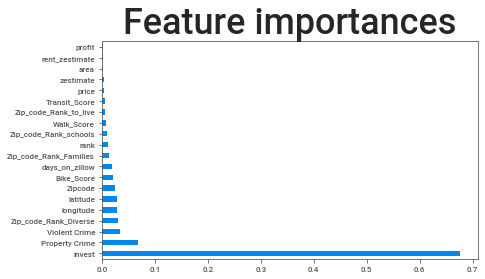

In [ ]:
y = final['invest']
X = final.drop(columns = ['invest'])
model = ExtraTreesClassifier(criterion='gini') # “gini” for the Gini impurity and “entropy” for the information gain.
model.fit(final, y)
print(model.feature_importances_) # use inbuilt class feature_importances of tree based classifiers
# plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=final.columns)
feat_importances.nlargest(20).plot(kind='barh')
plt.title("Feature importances")
plt.show()

In [ ]:
X.shape

(1563, 22)

In [ ]:
y.shape

(1563,)

Based on the Gini Importance of the features, it's obvious that area, property infrastructure, accessibility, price, safty, zestimate and zipcode are the most important factors to predict investment.

**SHAP**

In [ ]:
#train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

[0.00000000e+00 0.00000000e+00 1.68999632e-03 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 3.38999191e-01 0.00000000e+00 0.00000000e+00
 0.00000000e+00 4.25705335e-04 1.01638567e-01 5.57246540e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


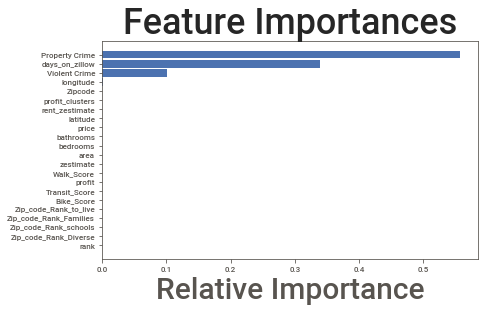

In [ ]:
rf = RandomForestRegressor(max_depth=5, random_state=0, n_estimators=10)
rf.fit(X_train, y_train)  
print(rf.feature_importances_)
importances = rf.feature_importances_
indices = np.argsort(importances)
features = X_train.columns
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

In [ ]:
explainer = shap.Explainer(rf)
expected_value = explainer.expected_value
shap_array = explainer.shap_values(X_test)

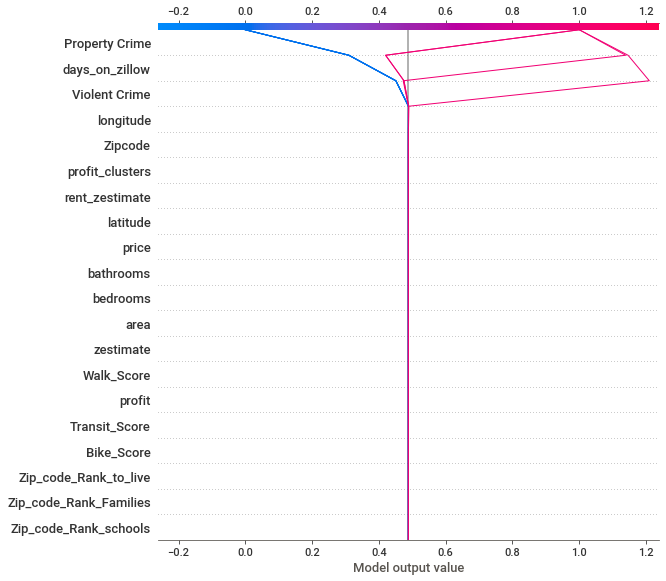

In [ ]:
shap.decision_plot(expected_value, shap_array[0:10],feature_names=list(X.columns))

**Heatmap and correlation**

In [ ]:
final.corr()

,rank,latitude,longitude,price,bathrooms,bedrooms,area,zestimate,rent_zestimate,days_on_zillow,...,Zipcode,Violent Crime,Property Crime,Zip_code_Rank_to_live,Zip_code_Rank_Families,Zip_code_Rank_schools,Zip_code_Rank_Diverse,profit,profit_clusters,invest
rank,1.000000,0.152163,0.135431,-0.060355,0.041068,0.030621,0.065394,-0.059735,-0.035058,0.176412,...,-0.091233,0.080740,0.161943,0.088161,0.112914,0.086296,-0.057660,-0.013056,NaN,0.150257
latitude,0.152163,1.000000,0.201876,-0.181507,-0.017911,0.041143,0.047828,-0.184917,-0.228237,-0.118761,...,-0.229630,0.016176,0.305509,0.290905,0.277363,0.203624,-0.092841,-0.085537,NaN,0.174397
longitude,0.135431,0.201876,1.000000,-0.199575,0.002647,0.024601,0.049045,-0.219919,-0.160920,-0.176229,...,-0.954914,0.155106,0.173981,0.037285,0.073532,0.083480,-0.200758,-0.239614,NaN,0.196017
price,-0.060355,-0.181507,-0.199575,1.000000,0.551110,0.426202,0.450048,0.993899,0.870651,0.014683,...,0.176258,-0.120875,-0.159136,-0.193218,-0.131202,-0.015297,0.127936,0.252918,NaN,-0.049488
bathrooms,0.041068,-0.017911,0.002647,0.551110,1.000000,0.640604,0.586282,0.543053,0.541483,-0.017213,...,0.032340,-0.045393,-0.017068,-0.063358,-0.039888,0.105486,-0.011540,0.098207,NaN,0.010973
bedrooms,0.030621,0.041143,0.024601,0.426202,0.640604,1.000000,0.502600,0.418337,0.394313,-0.065127,...,-0.029395,-0.030419,-0.060801,0.042754,-0.055276,0.083462,0.017315,0.061614,NaN,-0.044598
area,0.065394,0.047828,0.049045,0.450048,0.586282,0.502600,1.000000,0.441841,0.427627,-0.035590,...,0.005764,-0.012937,0.071921,-0.052334,0.058653,0.149179,-0.031097,0.065918,NaN,0.075048
zestimate,-0.059735,-0.184917,-0.219919,0.993899,0.543053,0.418337,0.441841,1.000000,0.877040,0.033089,...,0.194516,-0.132596,-0.165781,-0.190483,-0.134707,-0.016068,0.134724,0.358082,NaN,-0.052148
rent_zestimate,-0.035058,-0.228237,-0.160920,0.870651,0.541483,0.394313,0.427627,0.877040,1.000000,0.050208,...,0.150174,-0.109858,-0.159043,-0.208594,-0.138811,-0.031706,0.093474,0.322843,NaN,-0.044908
days_on_zillow,0.176412,-0.118761,-0.176229,0.014683,-0.017213,-0.065127,-0.035590,0.033089,0.050208,1.000000,...,0.144378,-0.102308,-0.119928,-0.084372,-0.061435,-0.040955,0.057429,0.165957,NaN,0.242896


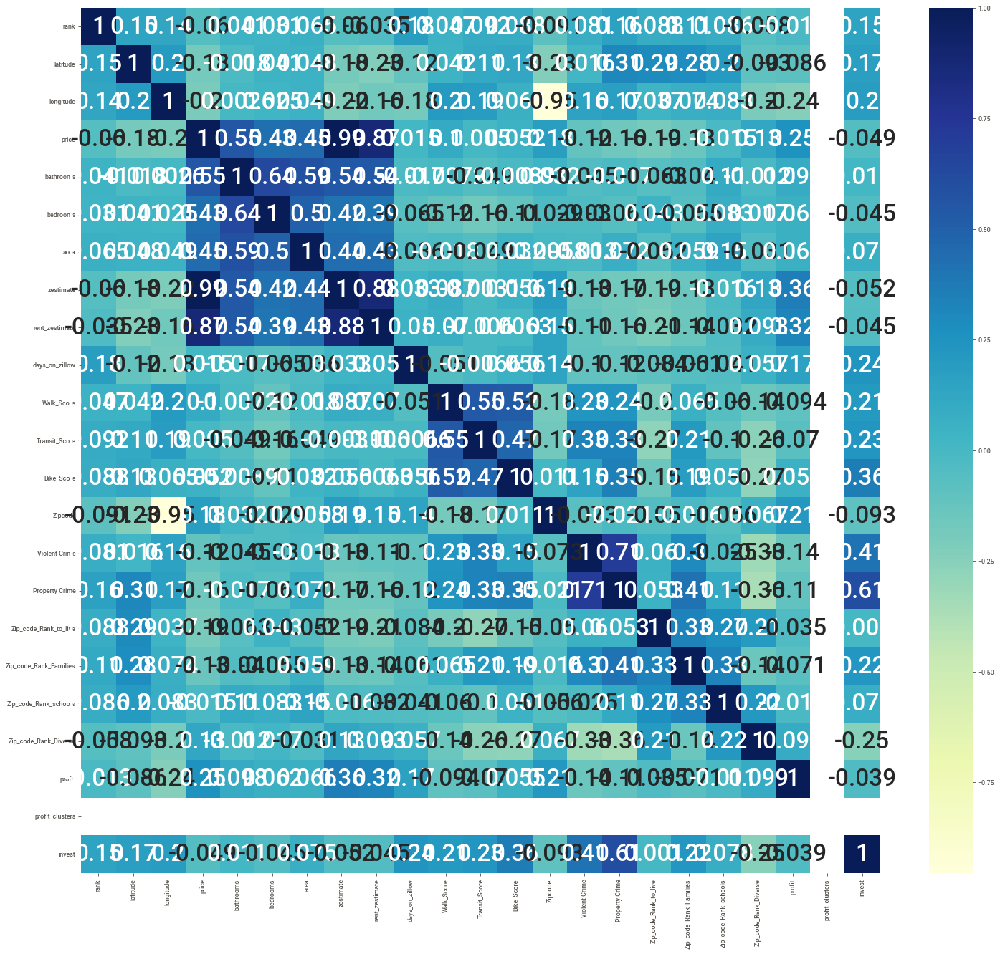

In [ ]:
from matplotlib.pyplot import figure

figure(figsize=(20, 20), dpi=80)
# plotting correlation heatmap
dataplot = sns.heatmap(final.corr(), cmap="YlGnBu", annot=True)
  
# displaying heatmap
plt.show()

### **Feature selection**

**Chi-squared Test**

In [ ]:
num_feats = 8

X_norm = MinMaxScaler().fit_transform(X)
chi_selector = SelectKBest(chi2, k=num_feats)
chi_selector.fit(X_norm, y)
chi_support = chi_selector.get_support()
chi_feature = X.loc[:,chi_support].columns.tolist()
print(str(len(chi_feature)), 'selected features')
print(chi_feature)

8 selected features
['rank', 'longitude', 'Transit_Score', 'Bike_Score', 'Violent Crime', 'Property Crime', 'Zip_code_Rank_Families', 'Zip_code_Rank_Diverse']


**Recursive Feature Elimination**

In [ ]:
rfe_selector = RFE(estimator=LogisticRegression(), n_features_to_select=num_feats, step=10, verbose=5)
rfe_selector.fit(X_norm, y)
rfe_support = rfe_selector.get_support()
rfe_feature = X.loc[:,rfe_support].columns.tolist()
print(str(len(rfe_feature)), 'selected features')
print(rfe_feature)

Fitting estimator with 22 features.
Fitting estimator with 12 features.
8 selected features
['longitude', 'price', 'zestimate', 'rent_zestimate', 'days_on_zillow', 'Bike_Score', 'Violent Crime', 'Property Crime']


**Lasso : SelectFromModel**

In [ ]:
embeded_lr_selector = SelectFromModel(LogisticRegression(penalty="l2"), max_features=num_feats)
embeded_lr_selector.fit(X_norm, y)

embeded_lr_support = embeded_lr_selector.get_support()
embeded_lr_feature = X.loc[:,embeded_lr_support].columns.tolist()
print(str(len(embeded_lr_feature)), 'selected features')

print(embeded_lr_feature)

5 selected features
['longitude', 'days_on_zillow', 'Bike_Score', 'Violent Crime', 'Property Crime']


**Tree-based: SelectFromModel**

In [ ]:
from sklearn.feature_selection import SelectFromModel
from lightgbm import LGBMClassifier

lgbc=LGBMClassifier(n_estimators=500, learning_rate=0.05, num_leaves=32, colsample_bytree=0.2,
            reg_alpha=3, reg_lambda=1, min_split_gain=0.01, min_child_weight=40)

embeded_lgb_selector = SelectFromModel(lgbc, max_features=num_feats)
embeded_lgb_selector.fit(X, y)

embeded_lgb_support = embeded_lgb_selector.get_support()
embeded_lgb_feature = X.loc[:,embeded_lgb_support].columns.tolist()
print(str(len(embeded_lgb_feature)), 'selected features')

print(embeded_lgb_feature)

8 selected features
['rank', 'latitude', 'longitude', 'days_on_zillow', 'Zipcode', 'Violent Crime', 'Property Crime', 'Zip_code_Rank_to_live']


**Using RandomForest**

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier

embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=100), max_features=num_feats)
embeded_rf_selector.fit(X, y)

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = X.loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features')

print(embeded_rf_feature)

5 selected features
['days_on_zillow', 'Zipcode', 'Violent Crime', 'Property Crime', 'Zip_code_Rank_Diverse']


**Aggregation of all feature selection methods**

In [ ]:
feature_name = X.columns
# put all selection together
# feature_selection_df = pd.DataFrame({'Feature':feature_name, 'Pearson':cor_support, 'Chi-2':chi_support, 'RFE':rfe_support, 'Logistics':embeded_lr_support,
#                                     'Random Forest':embeded_rf_support, 'LightGBM':embeded_lgb_support})
feature_selection_df = pd.DataFrame({'Feature':feature_name,'Chi-2':chi_support, 'RFE':rfe_support, 'Logistics':embeded_lr_support,
                                    'Random Forest':embeded_rf_support, 'LightGBM':embeded_lgb_support})
# count the selected times for each feature
feature_selection_df['Total'] = np.sum(feature_selection_df, axis=1)
# display the top 100
feature_selection_df = feature_selection_df.sort_values(['Total','Feature'] , ascending=False)
feature_selection_df.index = range(1, len(feature_selection_df)+1)
feature_selection_df.head(num_feats)

,Feature,Chi-2,RFE,Logistics,Random Forest,LightGBM,Total
1,Violent Crime,True,True,True,True,True,5
2,Property Crime,True,True,True,True,True,5
3,longitude,True,True,True,False,True,4
4,days_on_zillow,False,True,True,True,True,4
5,Bike_Score,True,True,True,False,False,3
6,rank,True,False,False,False,True,2
7,Zipcode,False,False,False,True,True,2
8,Zip_code_Rank_Diverse,True,False,False,True,False,2


Features selected as per different selection methods are as follows:
Walk_Score, price, bedrooms, bathrooms, area, violent crime and zestimate

### **Splitting data into training, testing and validation**

In [ ]:
features_selected = feature_selection_df[:5]['Feature']

In [ ]:
scaler = MinMaxScaler()
X = scaler.fit_transform(X.loc[: , features_selected])

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

In [ ]:
print(X_train.shape), print(y_train.shape)
print(X_test.shape), print(y_test.shape)

(937, 5)
(937,)
(626, 5)
(626,)


(None, None)

### **Modeling : MullerLoop**

In [ ]:
h = 0.02  # step size in the mesh

names = [
    "Nearest Neighbors",
    "Linear SVM",
    "RBF SVM",
    "Decision Tree",
    "Random Forest",
    "Neural Net",
    "Naive Bayes",
    "QDA",
]

classifiers = [
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    DecisionTreeClassifier(max_depth=3),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
]

In [ ]:
from time import time

max_score = 0.0
max_class = ''
clf_list = []
compare_data = []
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time()
    clf_model = name + "_model"
    clf_model = clf.fit(X_train, y_train)
    score = 100.0 * clf_model.score(X_test, y_test)
    compare_data.append([score, name, clf_model, (time() - start_time)])
    print('classifier = %s, Score (test, accuracy) = %.2f,' %(name, score))
    print('**************************************************************************')

    clf_list.append(clf_model)

    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(clf_list)
print(80*'-' )
print('Best --> classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))
#plot the output of the various algorithms

compare_model_mullerloop = pd.DataFrame(compare_data, columns=["score", "name", "classifier", "Time-elapsed"]).sort_values('score', ascending=False).reset_index(drop=True)

classifier = Nearest Neighbors, Score (test, accuracy) = 91.69,
**************************************************************************
classifier = Linear SVM, Score (test, accuracy) = 81.47,
**************************************************************************
classifier = RBF SVM, Score (test, accuracy) = 88.50,
**************************************************************************
classifier = Decision Tree, Score (test, accuracy) = 100.00,
**************************************************************************
classifier = Random Forest, Score (test, accuracy) = 98.56,
**************************************************************************
classifier = Neural Net, Score (test, accuracy) = 85.46,
**************************************************************************
classifier = Naive Bayes, Score (test, accuracy) = 93.61,
**************************************************************************
classifier = QDA, Score (test, accuracy) = 90.42,
**************

### **Model comparison - Metrics**

In [ ]:
compare_model_mullerloop

,score,name,classifier,Time-elapsed
0,100.000000,Decision Tree,DecisionTreeClassifier(max_depth=3),0.003525
1,98.562300,Random Forest,"(DecisionTreeClassifier(max_depth=5, max_features=1, random_state=1627459422), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=2027059818), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=1997385720), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=167298693), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=1956539614), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=2040804251), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=1858831685), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=24864984), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=1608325978), DecisionTreeClassifier(max_depth=5, max_features=1, random_state=2010803170))",0.023587
2,93.610224,Naive Bayes,GaussianNB(),0.003568
3,91.693291,Nearest Neighbors,KNeighborsClassifier(n_neighbors=3),0.020077
4,90.415335,QDA,QuadraticDiscriminantAnalysis(),0.003432
5,88.498403,RBF SVM,"SVC(C=1, gamma=2)",0.038628
6,85.463259,Neural Net,"MLPClassifier(alpha=1, max_iter=1000)",1.531983
7,81.469649,Linear SVM,"SVC(C=0.025, kernel='linear')",0.038761


**Plotting Variance in prediction quality of first 4 classifiers**

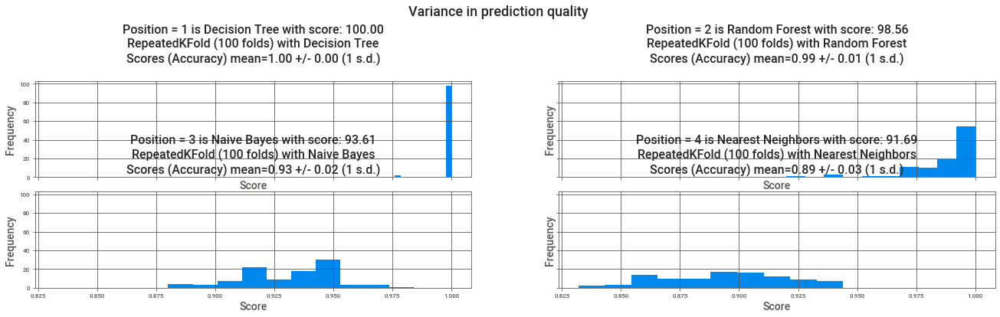

In [ ]:
#b. plot the various results from the top 3 classifiers.
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(20,6), sharex=True, sharey=True)
# fig, axs = plt.subplots(ncols=int(len(names)**2), nrows=int(len(names)**2), figsize=(28,24), sharex=True, sharey=True)
fig.suptitle("Variance in prediction quality",fontsize=18);
plt.subplots_adjust(left=None, bottom=None, right=None, top=0.75, wspace=None, hspace=0.15)


def show_subPlot(score, Nclf, title, ax, position=1, bins=10, n_repeats=20, X_label='Score', y_label='Frequency'):
    XVscores = cross_val_score(Nclf, X_test, y_test, cv=RepeatedKFold(n_repeats=n_repeats), n_jobs=-1)
    pd.Series(XVscores).hist(ax=ax, bins=bins)
    if y_label:
        ax.set_ylabel(y_label, fontsize=14)
    if X_label:
        ax.set_xlabel(X_label, fontsize=14)
    XVscores_line1 = f"RepeatedKFold ({len(XVscores)} folds) with {title}\n"
    XVscores_line2 = f"Scores (Accuracy) mean={XVscores.mean():0.2f} +/- {XVscores.std():0.2f} (1 s.d.)\n"
    ax.set_title(f"Position = {position} is {title} with score: {score:0.2f}\n" + XVscores_line1 + XVscores_line2, style='italic', fontsize=16);

i=0  
for ax in axs.flat:
   #show_subPlot(classifiers[i], names[i],   ax)  #Unsorted
   show_subPlot(compare_model_mullerloop['score'].values[i], compare_model_mullerloop['classifier'].values[i], compare_model_mullerloop['name'].values[i], ax, i+1)   #Sorted
   i +=1

**Plotting confusion matrix for top 4 classifiers**

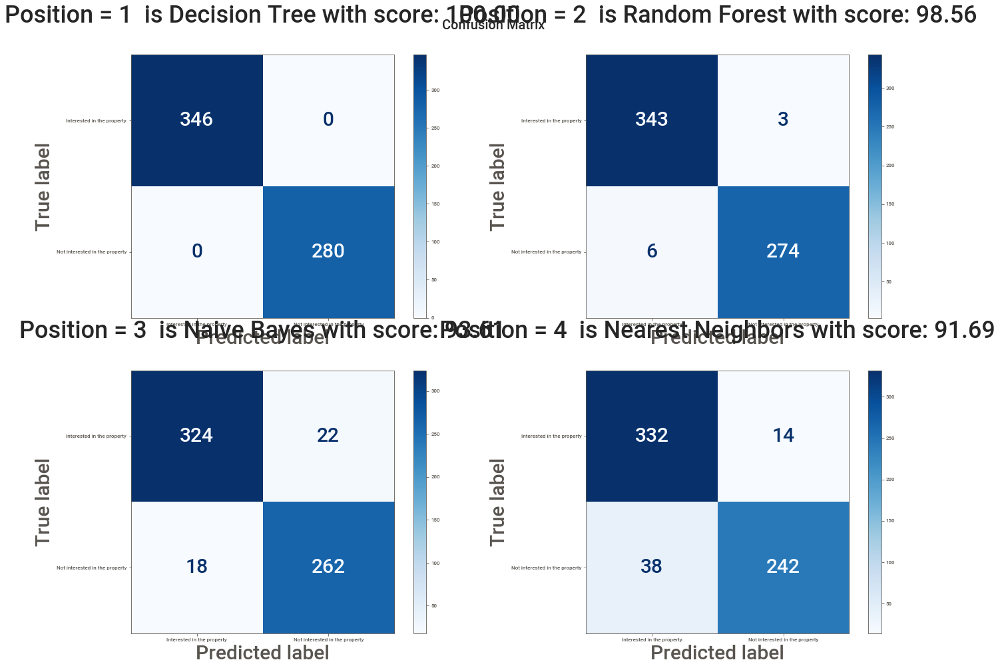

In [ ]:
from sklearn.metrics import plot_confusion_matrix

#plot the various results from the top 4 classifiers.
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(20,15))
plt.rcParams.update({'font.size': 30})
fig.suptitle("Confusion Matrix",fontsize=20);
plt.subplots_adjust(left=None, bottom=None, right=None, top=.93, wspace=None, hspace=None)

def show_confusionMatrix(score, clf, title, ax, position=1):
    class_names = ["Interested in the property", "Not interested in the property"]
    plotTitle= (f"Position = {position}  is {title} with score: {score:0.2f}\n") 
    plot_confusion_matrix(clf, 
                          X_test, 
                          y_test, 
                          display_labels=class_names,
                          ax=ax, 
                          cmap='Blues',
                          values_format='d')
    ax.title.set_text(plotTitle)

i=0  
for ax in axs.flat:
   show_confusionMatrix(compare_model_mullerloop['score'].values[i], compare_model_mullerloop['classifier'].values[i], compare_model_mullerloop['name'].values[i], ax, i+1)   #Sorted
   i +=1

plt.show()

### **Model Pickling**

In [ ]:
# Save the Model to file in the current working directory

filename = "DataMiners_MidTerm_classification_model.pkl"  
with open(filename, 'wb') as file:  
    pickle.dump(compare_model_mullerloop['classifier'].values[0], file)

In [ ]:
# Load the Model back from file
with open(filename, 'rb') as file:  
    Pickled_Model = pickle.load(file)

Pickled_Model

DecisionTreeClassifier(max_depth=3)

# **Conclusion**

## **Business Case and Value-- what hypotheses are you trying to prove?**
 
**Our main business use case is to find out what kind of real estate property is best to invest in (has the highest profit over years) for the user, based on all factores (walkability score, crime rate, school ranking, etc.)**

-  We came up with a golden cluster that groups properties which are  profitable, has all of the desirable features, and is located in a secure area. Various latent variables such as crime rate (property/violence), profit, walkability metrics (walk score, bike score, transit score), and zip code ranking measures are used for this. 
 
On top of that, we performed classification to find the likeability factor to invest and finally used regression techniques to predict the price of the property.

## **Data narrative: tell a story to guide an investor or a retiree or just someone interested in buying…**
- Using the Real_estate Dataset, we performed Data cleaning, Data Preparation and eliminated unwanted columns from the dataset by performing feature selection/Importance. Along with this we have also scraped data related to accessibility score, safety and zipcode ranking from the below mentioned websites to enrich the initial dataset, amalgamate it and improve the feature set and visualization to deduce the best model.
 
https://www.walkscore.com/
https://www.bestplaces.net/crime/
https://www.niche.com/places-to-live/

## **Visualizations, of data prep using first data enrichment (add a dataset to base data set)**
- Performed various visualization techniques to understand the data distribution and behavior. Used pairplot, barplot, line plot and pie chart to understand the relationship between features. 
- Tried Autoviz to understand more about features and data distribution.
 
## **Feature Importance - Gini score**
- We performed various feature importance techniques such as Pearson Correlation
,Chi-Squared, Recursive Feature Elimination, Lasso: SelectFromModel, Tree-based: SelectFromModel using Gini score and came up with the required features for our use case.

## **Data Preparation:**
First, we wrangled the data and removed irrelevant features, which contain a lot of NaN. We used different data imputation techniques such as knn Imputer , Iterative Imputer to impute the missing data.
Then we merged with multiple scraped datasets (Crime Rate, Walkability Score, Zip Code Ranking) to get the final enriched dataset for further analysis.

 
## **Feature Transformation:**
We Performed Feature transformation to transform the dataset to the desired format. Like extracting the State and Zipcode from the dataset. We performed a min-max scaler to uniformly scale the data distribution.   We transformed existing features, added new features to the dataset via amalgamations (Crime Rate info, Walkability info, Zip Code Ranking info, etc..).

## **Dimensionality Reduction via PCA**
We performed dimensionality reduction to the dataset to reduce the  no. of dimensions  to 2 for the purpose of visualizing the data distribution.

## **Implement 3 amalgamations:**

The first data set is the initial dataset provided by the professor for the exam.

**For the First Data Enrichment,** we used the Walkability score(Walk Score, Bike Score, Transit Score)

By scraping the dataset from https://www.walkscore.com/  to the necessary scores for each Zillow property in the dataset.

**How many did you scrape?**We were able to scrap Walkability info for all properties in the initial dataset.

**Second Data Enrichment**we used the Crime score(Violent Crime, Property Crime)  for each locality like zipcode.

By scraping the dataset from https://www.bestplaces.net/crime/  to get the necessary scores for each Zillow property in the first dataset.

**How many did you scrape?** We were able to scrap crime info for all zip codes extracted from the dataset


**Third Data enrichment**-- we used the Zip Code Ranking(School Ranking, Family Ranking, Diversity Ranking and liveability Ranking)  for each Zip Code.

By scraping the dataset from https://www.niche.com/places-to-live/  to get the necessary school ranking around each Zillow property in the first dataset.

**How many did you scrape?** We were able to scrap School Ranking info for all zip codes extracted from the dataset.
 
 
## **Golden Cluster: (Define a Golden cluster and use Fractal Clustering to find it based on the business case you formulate)**
https://colab.research.google.com/drive/1sbd9-TjMl01Ew_NpJg8-aFfMsgpdWv-e#scrollTo=9KlJtxp7bntV
 
Our golden cluster meets the below criteria, where it has properties that are safe and yields high profit , good walkability score and reasonable zip code rank for living.
 
​​During the First Analysis, We ran Kmeans on the entire features of the dataset and used elbow method and cluster metrics like: silhouette_score, calinski_harabasz_score, davies_bouldin_score to understand  the clusters created from the dataset. 
 
With the method described above, we were unable to reach any conclusions. We felt that performing fractal clustering with different objective functions and finding the golder cluster that solves our marketing problem would be one method to come up with a solution for our use case.
 
We clustered based on Walkability in the first Kmeans iteration to select clusters that included properties with greater walkability scores.
 
We clustered using Crime Rate on Top of Walkability Cluster in the Second Kmeans Iteration to arrive at clusters that are extremely secure and have a high walk score.
 
We clustered using the Profit feature (Zestimate - Price) on top of the aforementioned iterated cluster in the last Kmeans iteration to achieve clusters with high Profit, secure, and walkability scores. Which is our analysis' key performance indicator.
 
Finally we arrived at our golder Cluster with around 1.5K properties related to our use case. 
 
## **Classification:**
**https://colab.research.google.com/drive/1sbd9-TjMl01Ew_NpJg8-aFfMsgpdWv-e#scrollTo=WXt_ytp8GngP**
We performed classification on the golden cluster based on likeability (Investment criteria) factors. Here the model classifies whether to invest on the property or not based on the criteria provided by the user. 
Initially, feature extraction is performed to come up with an ‘Invest’ feature based on user likeability criteria. 
 
In order to get the features that influence the invest feature, we performed feature selection using techniques such as Chi-Squared, Recursive Feature Elimination, Lasso: SelectFromModel, Tree-based: SelectFromModel, Gini Index, heatmap and correlation.
 
Finally, we used Muller- loop that comprises of different classification techniques such as Nearest Neighbors, Linear SVM, RBF SVM, Decision Tree, Random Forest, Neural Net, Naive Bayes,QDA to classify if the property is worth investing or not based on the features obtained from feature selection and Investment criteria
 
## **Regression:**
**https://colab.research.google.com/drive/1sbd9-TjMl01Ew_NpJg8-aFfMsgpdWv-e#scrollTo=WXt_ytp8GngP**
 
We use several regression techniques to predict the profit one can earn from each property based on the given factors (Walkability, School Ranking around the neighborhood, etc), and use Muller Loop to find out the best regression technique for the case based on r2 Score, Mean Squared Error, and Squared Root Mean Error.
Regression Techniques Used:
Linear Regression, Random Forest Regressor, KNN Regression, MLPRegressor, Decision Tree Regression, AdaBoost Regression, Gaussian Regression, Ridge Regression

## **Implement ml algorithms to build models and refine your data narrative:**
**Classification : **
 
we used Muller- loop that comprises of different classification techniques such as Nearest Neighbors, Linear SVM, RBF SVM, Decision Tree, Random Forest, Neural Net, Naive Bayes,QDA to classify if the property is worth investing or not based on the features obtained from feature selection and likeability criteria.
 
**Regression :**
 
we used Muller- loop that comprises of different regression techniques such as Linear Regression, Random Forest Regressor, KNN Regression, MLPRegressor, Decision Tree Regression, AdaBoost Regression, Gaussian Regression, Ridge Regression to predict the property price based on the features obtained from feature selection techniques.

## **Compare relevant tasks in the same table:**
We have a dataframe that captures the performance metric for different algorithms for classification and regression use cases.

**Write a data narrative to interpret the results of each algorithm**
 
**Classification** : **https://colab.research.google.com/drive/1sbd9-TjMl01Ew_NpJg8-aFfMsgpdWv-e#scrollTo=TQXANAsV2B3U&line=1&uniqifier=1**
 
Since we refined our data to meet our business requirements. All Classification algorithms performed well on most occasions.
 
**Analysis of different classification algorithms:**
 
Decision Tree /Random forest(Multiple decision trees) provided a better performance for our investment criteria. Since it was able to understand the features in the come up with conclusions, One aspect of the decision tree is that it memorizes the info in the data and may have the ability to overfit for different validation cases which do not meet our  required criteria. Mostly, the Perfect Decision tree always performs better on training data and mostly has high variance  in the validation data.
 
Knn Algorithms are pretty simple and provide an easy approach to solve classification problems. Since our domain features used in our  uscases are correlated , it was able to choose classes easily since the data has high separability. The core of this classifier depends mainly on measuring the distance or similarity between the tested examples and the training examples.
Its performance was pretty good considering its simplicity for our classification criteria.
 
A Naive Bayes classifier is a probabilistic machine learning model that’s used for classification task. It is based on Bayes theorem.
With this approach we can find the probability of our investment criteria with all the dependent features in the dataset and come up with conclusions. It provided good classification metrics.
Different Performance metrics  are used  for our domain and were visualized for  further understanding.
 
**Regression:**
**https://colab.research.google.com/drive/1sbd9-TjMl01Ew_NpJg8-aFfMsgpdWv-e#scrollTo=CfiysxDwWQ9G&line=1&uniqifier=1**

Linear Regression performed better in predicting the property price based on the important features. Because it  predicts the value in the continuous range instead of classifying the values into categories.
It was able to draw a best fit line since there was a strong correlation with the dependent features in the dataset. 

When the features are highly correlated with the predicted variable, Ridge Regression performed effectively. It provides generalization to our model  to avoid overfitting and underfitting(Low Bias and Low Variance). Our dataset features have high correlation in our price prediction and were able to perform well and come up with a good regression line to satisfy our use case similar to linear regression. When the dataset has multicollinearity then Ridge regression can come to rescue for our problem domain.
 
## **Suggest Latent Variables or Latent Manifolds:**
Walk_Score
Transit_Score
Bike_Score
Violent Crime
Property Crime
Zip_code_Rank_to_live
Zip_code_Rank_Families
Zip_code_Rank_schools
Zip_code_Rank_Diverse
possible profit(zestimate-price)
Adding these features to the initial dataset models accuracy increased and performed better in clustering properties, predicting price of properties and classifying if the property is worth investment or not.

**use appropriate metrics for measuring models and compare them in a table: regression metrics and/or classification metrics (confusion matrix, f1)**
**https://colab.research.google.com/drive/1sbd9-TjMl01Ew_NpJg8-aFfMsgpdWv-e#scrollTo=DxDIHUlu2DL3&line=1&uniqifier=1**

